# Projet Movies Database - Mangodb cloud

In [61]:
#import dependencies
from bson.objectid import ObjectId
from pymongo import MongoClient
import pymongo
from collections import Counter
from pprint import pprint
import pandas as pd

## viz
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

%matplotlib inline
plt.style.use('seaborn-dark-palette')


## configure client (cloud mangodb)
uri= "url"
client = MongoClient(uri)

## Connexion à la BDD Mflix

In [2]:
#Let's use the sample_mflix database, display available collections
dbmflix = client["sample_mflix"]
dbmflix.list_collection_names()

['comments', 'theaters', 'users', 'sessions', 'movies']

In [4]:
# Afficher le nombre de documents par collection
for e in dbmflix.list_collection_names():
    print("***********************")
    print("Nombre de documents dans la collection "+e+" : "+str(dbmflix[e].count_documents({})))

***********************
Nombre de documents dans la collection comments : 41079
***********************
Nombre de documents dans la collection theaters : 1564
***********************
Nombre de documents dans la collection users : 185
***********************
Nombre de documents dans la collection sessions : 1
***********************
Nombre de documents dans la collection movies : 23530


In [3]:
####### UTILS #######
def pretty(x):
    pprint(list(x))

## Exploiter les données de Mflix

### Part 1

In [5]:
## Afficher un document(quelconque) de la collection movies
movies = dbmflix.movies
movies.find_one({})

{'_id': ObjectId('573a1390f29313caabcd4135'),
 'plot': 'Three men hammer on an anvil and pass a bottle of beer around.',
 'genres': ['Short'],
 'runtime': 1,
 'cast': ['Charles Kayser', 'John Ott'],
 'num_mflix_comments': 0,
 'title': 'Blacksmith Scene',
 'fullplot': 'A stationary camera looks at a large anvil with a blacksmith behind it and one on either side. The smith in the middle draws a heated metal rod from the fire, places it on the anvil, and all three begin a rhythmic hammering. After several blows, the metal goes back in the fire. One smith pulls out a bottle of beer, and they each take a swig. Then, out comes the glowing metal and the hammering resumes.',
 'countries': ['USA'],
 'released': datetime.datetime(1893, 5, 9, 0, 0),
 'directors': ['William K.L. Dickson'],
 'rated': 'UNRATED',
 'awards': {'wins': 1, 'nominations': 0, 'text': '1 win.'},
 'lastupdated': '2015-08-26 00:03:50.133000000',
 'year': 1893,
 'imdb': {'rating': 6.2, 'votes': 1189, 'id': 5},
 'type': 'blabla

In [28]:
## Combien y a t il de documents avec l'attribut year en string? et combien sont ils en int ?

types = Counter(['string' if type(e["year"])==str else "integer" for e in list(movies.find({ },{"year":1,"_id":0}))])

print("En int : "+str(types['integer']))
print("En string : "+str(types['string']))

En int : 23494
En string : 36


In [48]:
##Trouver un film avec "Salma Hayek" en tant qu'acteur
pretty(movies.find({"cast" : {"$all": ["Salma Hayek"]}}).limit(1))

[{'_id': ObjectId('573a1399f29313caabceea6d'),
  'awards': {'nominations': 1, 'text': '1 nomination.', 'wins': 0},
  'cast': ['David Arquette', 'John Hawkes', 'Salma Hayek', 'Jason Wiles'],
  'countries': ['USA'],
  'directors': ['Robert Rodriguez'],
  'fullplot': "Cynical look at a 50's rebellious Rocker who has to confront "
              'his future, thugs with knives, and the crooked town sheriff.',
  'genres': ['Action', 'Drama'],
  'imdb': {'id': 111002, 'rating': 6.7, 'votes': 2036},
  'languages': ['English'],
  'lastupdated': '2015-09-01 00:53:54.567000000',
  'num_mflix_comments': 1,
  'plot': "Cynical look at a 50's rebellious Rocker who has to confront his "
          'future, thugs with knives, and the crooked town sheriff.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMTgwMzU3MDI1NF5BMl5BanBnXkFtZTcwMDUwMTIyMQ@@._V1_SY1000_SX677_AL_.jpg',
  'rated': 'R',
  'released': datetime.datetime(1994, 7, 22, 0, 0),
  'runtime': 95,
  'title': 'Roadracers',
  'tomatoes': {'

In [41]:
#Combien de films ou "Salma Hayek" a participé, afficher ces documents en se limitant au title et la liste des acteurs
movies.count_documents({"cast" : {"$all": ["Salma Hayek"]}})

21

In [49]:
#Afficher les 3 premiers films ou "Salma Hayek" a participé, afficher uniquement le title
pretty(movies.find({"cast" : {"$all": ["Salma Hayek"]}},{"title":1,"_id":0}).limit(3))

[{'title': 'Roadracers'}, {'title': 'Midaq Alley'}, {'title': 'Desperado'}]


In [45]:
## Combien de films nommés: "The Journey", la fonction find() retourne un objet itérable et non pas un document !
movies.count_documents({"title" : {"$eq": "The Journey"}})

6

In [47]:
## Afficher pour chaque document :le titre, l'année et la liste des genres .
pretty(movies.find({"title" : {"$eq": "The Journey"}},{"title":1,"year":1,"genres":1,"_id":0}))

[{'genres': ['Drama'], 'title': 'The Journey', 'year': 1986},
 {'genres': ['Drama', 'History'], 'title': 'The Journey', 'year': 1992},
 {'genres': ['Comedy', 'Drama'], 'title': 'The Journey', 'year': 1997},
 {'genres': ['Documentary', 'Adventure'], 'title': 'The Journey', 'year': 2001},
 {'genres': ['Drama', 'Romance'], 'title': 'The Journey', 'year': 2004},
 {'genres': ['Comedy', 'Drama', 'Family'],
  'title': 'The Journey',
  'year': 2014}]


### Part 2

#### Afficher les 12 titres de la collection movies à partir du dixième inclus ,

In [59]:
pretty(movies.find({},{'_id':0, 'title':1}).skip(9).limit(12))

[{'title': 'The Birth of a Nation'},
 {'title': 'The Cheat'},
 {'title': 'The Italian'},
 {'title': 'Regeneration'},
 {'title': 'Les vampires'},
 {'title': 'Civilization'},
 {'title': "Hell's Hinges"},
 {'title': "Intolerance: Love's Struggle Throughout the Ages"},
 {'title': 'Where Are My Children?'},
 {'title': 'The Immigrant'},
 {'title': 'The Poor Little Rich Girl'},
 {'title': 'Wild and Woolly'}]


#### afficher le résultat trié par ordre alphabétique décroissant

In [62]:
pretty(movies.find({},{'_id':0, 'title':1}).sort("title",-1))

[{'title': 'èxtasis'},
 {'title': 'èvocateur: The Morton Downey Jr. Movie'},
 {'title': 'èrido Movie'},
 {'title': 'èon Flux'},
 {'title': 'èlisa'},
 {'title': 'èkte vare'},
 {'title': 'èke och hans vèrld'},
 {'title': 'èdipussi'},
 {'title': 'èber uns das All'},
 {'title': 'èVivan las Antipodas!'},
 {'title': 'èAy, Carmela!'},
 {'title': 'èA volar joven!'},
 {'title': 'è nos amours'},
 {'title': 'è moi seule'},
 {'title': 'è Tout de Suite'},
 {'title': 'è Paè, è'},
 {'title': 'è Nous la Libertè'},
 {'title': 'xXx: State of the Union'},
 {'title': 'xXx'},
 {'title': 'tom thumb'},
 {'title': 's/y Glèdjen'},
 {'title': 'iMurders'},
 {'title': 'eXistenZ'},
 {'title': '[Rec] 2'},
 {'title': '[Rec]'},
 {'title': '[REC] 4: Apocalypse'},
 {'title': '[REC] 3: Genesis'},
 {'title': 'Zènik domu Usheru'},
 {'title': 'Zywot Mateusza'},
 {'title': 'Zvezda'},
 {'title': 'Zuzu Angel'},
 {'title': 'Zus & zo'},
 {'title': 'Zurich'},
 {'title': 'Zulu Dawn'},
 {'title': 'Zulu'},
 {'title': 'Zuckerbaby'},

 {'title': 'Firewall'},
 {'title': 'Firestorm'},
 {'title': 'Firestarter 2: Rekindled'},
 {'title': 'Firestarter 2: Rekindled'},
 {'title': 'Firestarter'},
 {'title': 'Fires on the Plain'},
 {'title': 'Fires on the Plain'},
 {'title': 'Firelight'},
 {'title': 'Firehouse Dog'},
 {'title': 'Fireflies in the Garden'},
 {'title': 'Fired Up!'},
 {'title': 'Firecracker'},
 {'title': 'Fireball'},
 {'title': 'Fire-Eater'},
 {'title': 'Fire!'},
 {'title': 'Fire with Fire'},
 {'title': 'Fire on the Mountain'},
 {'title': 'Fire of Conscience'},
 {'title': 'Fire in the Sky'},
 {'title': 'Fire in the Blood'},
 {'title': 'Fire in Castilla (Tactilvision from the Moor of the Fright)'},
 {'title': 'Fire in Babylon'},
 {'title': 'Fire Down Below'},
 {'title': 'Fire'},
 {'title': 'Fire'},
 {'title': 'Firaaq'},
 {'title': 'Fiorile'},
 {'title': 'Fiona'},
 {'title': 'Finsterworld'},
 {'title': 'Finnish Blood Swedish Heart'},
 {'title': 'Finisterrae'},
 {'title': "Finian's Rainbow"},
 {'title': 'Fingersmith

#### Lister ts les films produits en 1979 ?

In [65]:
pretty(movies.find({"year":{"$eq":1979}}))

[{'_id': ObjectId('573a1397f29313caabce6724'),
  'awards': {'nominations': 1, 'text': '1 win & 1 nomination.', 'wins': 1},
  'cast': ['Elsa Alarcèn',
           'Jorge èlvarez',
           'Luis Alarcèn',
           'Magdalena Aguirre'],
  'countries': ['Chile'],
  'directors': ['Silvio Caiozzi'],
  'fullplot': 'This is the story of a teenager at the turn of the century in '
              'the conservative higher classes of Chile and the initiation '
              'rites in his society.',
  'imdb': {'id': 76247, 'rating': 7.3, 'votes': 190},
  'languages': ['Spanish', 'French'],
  'lastupdated': '2015-08-20 01:20:55.343000000',
  'num_mflix_comments': 0,
  'plot': 'This is the story of a teenager at the turn of the century in the '
          'conservative higher classes of Chile and the initiation rites in '
          'his society.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMTYzMDY1NDk0OV5BMl5BanBnXkFtZTcwOTQ5NzA0MQ@@._V1_SY1000_SX677_AL_.jpg',
  'released': datetime.dateti

#### Afficher les infos sur le film dont le title est "Alien" produit en 1979 ?

In [64]:
pretty(movies.find({"title":{"$eq":"Alien"},"year":{"$eq":1979}}))

[{'_id': ObjectId('573a1397f29313caabce7084'),
  'awards': {'nominations': 19,
             'text': 'Won 1 Oscar. Another 15 wins & 19 nominations.',
             'wins': 16},
  'cast': ['Tom Skerritt',
           'Sigourney Weaver',
           'Veronica Cartwright',
           'Harry Dean Stanton'],
  'countries': ['USA', 'UK'],
  'directors': ['Ridley Scott'],
  'fullplot': 'A commercial crew aboard the deep space towing vessel, Nostromo '
              'is on its way home when they pick an SOS warning from a distant '
              "planet. What they don't know is that the SOS warning is not "
              'like any other ordinary warning call. Picking up the signal, '
              'the crew realize that they are not alone on the spaceship when '
              'an alien stowaway is on the cargo ship.',
  'genres': ['Horror', 'Sci-Fi'],
  'imdb': {'id': 78748, 'rating': 8.5, 'votes': 502112},
  'languages': ['English', 'Spanish'],
  'lastupdated': '2015-08-31 00:49:26.013000000',
 

#### Trouver ts les films qui ont gagné 100 awards ?

In [66]:
pretty(movies.find({"awards.wins":{"$eq":100}}))

[{'_id': ObjectId('573a13c1f29313caabd636b4'),
  'awards': {'nominations': 116,
             'text': 'Nominated for 6 Oscars. Another 94 wins & 116 '
                     'nominations.',
             'wins': 100},
  'cast': ['George Clooney', 'Vera Farmiga', 'Anna Kendrick', 'Jason Bateman'],
  'countries': ['USA'],
  'directors': ['Jason Reitman'],
  'fullplot': 'Ryan Bingham is a corporate downsizing expert whose cherished '
              'life on the road is threatened just as he is on the cusp of '
              "reaching ten million frequent flyer miles and just after he's "
              'met the frequent-traveler woman of his dreams.',
  'genres': ['Drama', 'Romance'],
  'imdb': {'id': 1193138, 'rating': 7.5, 'votes': 255243},
  'languages': ['English'],
  'lastupdated': '2015-09-04 00:10:08.833000000',
  'metacritic': 83,
  'num_mflix_comments': 0,
  'plot': 'With a job traveling around the country firing people, Ryan Bingham '
          'enjoys his life living out of a suitcas

### Tous les films dont le titre commence par 'Re' ?

In [70]:
pretty(movies.find({"title":{"$regex":"^Re"}})) ## ,{"_id":0,"title":1} projection if we want to verify rapidly the result

[{'_id': ObjectId('573a1390f29313caabcd587d'),
  'awards': {'nominations': 0, 'text': '1 win.', 'wins': 1},
  'cast': ['John McCann', 'James A. Marcus', 'Maggie Weston', 'Harry McCoy'],
  'countries': ['USA'],
  'directors': ['Raoul Walsh'],
  'fullplot': 'At 10 years old, Owens becomes a ragged orphan when his sainted '
              'mother dies. The Conways, who are next door neighbors, take '
              'Owen in, but the constant drinking by Jim soon puts Owen on the '
              'street. By 17, Owen learns that might is right. By 25, Owen is '
              'the leader of his own gang who spend most of their time '
              'gambling and drinking. But Marie comes into the gangster area '
              'of town and everything changes for Owen as he falls for Marie. '
              'But he cannot tell her so, so he comes to her settlement to '
              'find education and inspiration. But soon, his old way of life '
              'will rise to confront him again.',
 

#### Tous les films produits après 2010 et avant 2015 ?

In [71]:
pretty(movies.find({"year":{"$lte":2015,"$gte":2010}}))

[{'_id': ObjectId('573a139cf29313caabcf6fb1'),
  'awards': {'nominations': 5, 'text': '4 wins & 5 nominations.', 'wins': 4},
  'cast': ['èva Gèbor', 'Istvèn Znamenèk', 'èkos Horvèth', 'Lia Pokorny'],
  'countries': ['Hungary', 'France', 'Austria', 'Netherlands'],
  'directors': ['ègnes Kocsis'],
  'fullplot': 'A lonely obese nurse, working at a hospital terminal ward, is '
              'reminded of her childhood friend Adrienn Pal and wants to track '
              'her down.',
  'genres': ['Drama'],
  'imdb': {'id': 146592, 'rating': 6.8, 'votes': 348},
  'languages': ['Hungarian'],
  'lastupdated': '2015-09-01 01:00:29.427000000',
  'num_mflix_comments': 1,
  'plot': 'A lonely obese nurse, working at a hospital terminal ward, is '
          'reminded of her childhood friend Adrienn Pal and wants to track her '
          'down.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BODNjZmM3MWYtYmUwZC00M2RjLTkyZmEtYzRhMDU1NmM3ZmIzXkEyXkFqcGdeQXVyOTAzODAwOQ@@._V1_SY1000_SX677_AL_.jpg',

 {'_id': ObjectId('573a13bff29313caabd5f959'),
  'awards': {'nominations': 30,
             'text': 'Won 1 Golden Globe. Another 8 wins & 30 nominations.',
             'wins': 9},
  'cast': ['Al Pacino', 'Brenda Vaccaro', 'John Goodman', "Deirdre O'Connell"],
  'countries': ['USA'],
  'directors': ['Barry Levinson'],
  'fullplot': 'Dr. Jack Kevorkian (1928 - 2011 ) in the 1990s, when he defies '
              'Michigan law assisting the suicide of terminally-ill persons. '
              'Support comes from his sister, a lab tech, the Hemlock Society '
              'president, and a lawyer. The child of survivors of the Armenian '
              'genocide interviews applicants: his sister video tapes them. He '
              'assembles a device allowing a person to initiate a '
              'three-chemical intravenous drip. The local D.A., the governor, '
              'and the Legislature respond. In court scenes, Kevorkian is '
              "sometimes antic. He's single-minded abou

  'runtime': 88,
  'title': 'Mars Needs Moms',
  'tomatoes': {'boxOffice': '$21.4M',
               'consensus': "The cast is solid and it's visually well-crafted, "
                            'but Mars Needs Moms suffers from a lack of '
                            'imagination and heart.',
               'critic': {'meter': 37, 'numReviews': 111, 'rating': 5.0},
               'dvd': datetime.datetime(2011, 8, 9, 0, 0),
               'fresh': 41,
               'lastUpdated': datetime.datetime(2015, 9, 13, 18, 21, 53),
               'production': 'Walt Disney Pictures',
               'rotten': 70,
               'viewer': {'meter': 41, 'numReviews': 27475, 'rating': 3.0},
               'website': 'http://disney.go.com/marsneedsmoms'},
  'type': 'movie',
  'writers': ['Simon Wells (screenplay)',
              'Wendy Wells (screenplay)',
              'Berkeley Breathed (book)'],
  'year': 2011},
 {'_id': ObjectId('573a13c3f29313caabd6a004'),
  'awards': {'nominations': 0, 'text':

  'type': 'movie',
  'writers': ['Ehren Kruger'],
  'year': 2011},
 {'_id': ObjectId('573a13c5f29313caabd70cbf'),
  'awards': {'nominations': 95,
             'text': 'Nominated for 4 Oscars. Another 75 wins & 95 '
                     'nominations.',
             'wins': 79},
  'cast': ['Jennifer Lawrence',
           'Isaiah Stone',
           'Ashlee Thompson',
           'Valerie Richards'],
  'countries': ['USA'],
  'directors': ['Debra Granik'],
  'fullplot': 'With an absent father and a withdrawn and depressed mother, 17 '
              'year-old Ree Dolly keeps her family together in a dirt poor '
              "rural area. She's taken aback however when the local Sheriff "
              'tells her that her father put up their house as collateral for '
              "his bail and unless he shows up for his trial in a week's time, "
              'they will lose it all. She knows her father is involved in the '
              'local drug trade and manufactures crystal meth, but e

 {'_id': ObjectId('573a13c8f29313caabd777c2'),
  'awards': {'nominations': 2, 'text': '2 nominations.', 'wins': 0},
  'cast': ['Daniel Bedford', 'Maja Borg', 'Colin D. Calway', 'Orlando Capote'],
  'countries': ['UK', 'Sweden'],
  'directors': ['Maja Borg'],
  'fullplot': 'A film about love and utopia.',
  'genres': ['Documentary'],
  'imdb': {'id': 1495768, 'rating': 7.3, 'votes': 101},
  'languages': ['English'],
  'lastupdated': '2015-04-02 01:03:55.293000000',
  'num_mflix_comments': 0,
  'plot': 'A film about love and utopia.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMjE2MDE1NTY0MV5BMl5BanBnXkFtZTgwMTUyNjQ4MTE@._V1_SY1000_SX677_AL_.jpg',
  'released': datetime.datetime(2013, 6, 26, 0, 0),
  'runtime': 97,
  'title': 'Future My Love',
  'tomatoes': {'critic': {'meter': 67, 'numReviews': 6, 'rating': 6.0},
               'fresh': 4,
               'lastUpdated': datetime.datetime(2015, 5, 29, 20, 24, 20),
               'rotten': 2,
               'viewer': {'numReviews

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



'directors': ['Lenny Abrahamson'],
  'fullplot': 'What Richard Did follows Richard Karlsen, golden-boy athlete '
              'and undisputed alpha-male of his privileged set of South Dublin '
              'teenagers, through the summer between the end of school and the '
              'beginning of university. The world is bright and everything '
              'seems possible, until in one summer night Richard does '
              'something that destroys it all and shatters the lives of the '
              'people closest to him. What Richard Did is a quietly '
              'devastating study of a boy confronting the gap between who he '
              'thought he was and who he proves to be.',
  'genres': ['Drama'],
  'imdb': {'id': 2092011, 'rating': 6.3, 'votes': 2930},
  'languages': ['English', 'Irish'],
  'lastupdated': '2015-08-10 00:36:14.113000000',
  'metacritic': 80,
  'num_mflix_comments': 0,
  'plot': 'What Richard Did follows Richard Karlsen, golden-boy athlete and '


  'fullplot': 'Raghunandan is an ex-Bank of England employee who resigned his '
              'lucrative job because he was bored with the rather sedentary '
              'and mundane nature of his work. he chose journalism as his next '
              'career and worked in different cities in India. He now works '
              'for a TV news channel as an interviewer in a popular show named '
              '"Show the Spirit". In the mean time, he is in the process of '
              'writing an English novel too. He is essentially a loner but is '
              'a compulsive alcoholic and has an expensive collection of '
              'vintage drinks at home. It was his excessive drinking that '
              'resulted in his divorce some years back, but he shares a '
              'healthy friendship with his ex-wife Meera and her current '
              "husband Alexy. The couple have custody of Raghunandan's and "
              "Meera's son Aditya a.k.a Sunny, who is deaf and mute

               'production': 'CJ Entertainment',
               'viewer': {'meter': 62, 'numReviews': 236, 'rating': 3.4}},
  'type': 'movie',
  'writers': ['Sang-hoon Ahn (screenplay)', 'Dong-won Kim (screenplay)'],
  'year': 2012},
 {'_id': ObjectId('573a13d9f29313caabdaa675'),
  'awards': {'nominations': 1, 'text': '1 win & 1 nomination.', 'wins': 1},
  'cast': ['Paula Garcès', 'Annabella Sciorra', 'Bill Camp', 'Philip Ettinger'],
  'countries': ['USA'],
  'directors': ['Michael Walker'],
  'fullplot': 'Set entirely on the posh east end of Long Island (where it was '
              "filmed), THE MAID'S ROOM centers around Drina, an attractive, "
              'intelligent immigrant who takes a job for the season as live-in '
              'maid to the Crawfords, a privileged New York family who '
              'maintain a splendid home in the Hamptons. The job could be '
              'worse, since Mr. and Mrs. Crawford spend most of their time in '
              'the city, but their

  'countries': ['South Korea'],
  'directors': ['Dong-hoon Choi'],
  'fullplot': 'In order to let things cool down from their latest heist, '
              'Popeye and his group of thieves go to Macau on a job. But the '
              "mastermind behind this job is none other than Popeye's old "
              'partner Macau Park, who escaped with 68kg of gold several years '
              'ago on their last job together. Macau Park brought Chinese '
              'thieves as well but little did they know what Macau Park '
              'planned for each one of them. His plan takes an unexpected turn '
              'when Popeye brings Pepsi, a genius safe-cracker and old flame '
              "of Macau Park, to settle the old score. The thieves' target is "
              "a $20 million diamond known as 'Tear of the Sun', kept safely "
              'away in a casino, brought there to be sold by a notorious '
              'Chinese fence. While working together to steal this fabled '
  

  'fullplot': 'In a city where 13 ambulances struggle to serve 2 million '
              'people, Krassi, Mila and Plamen are our unlikely heroes: '
              'chain-smoking, filled with humour, relentlessly saving lives '
              'against all odds. Yet, the strain of a broken system is taking '
              "a human toll: how long can they keep fixing society's injured "
              'until they lose their empathy?',
  'genres': ['Documentary'],
  'imdb': {'id': 2378465, 'rating': 7.5, 'votes': 283},
  'languages': ['Bulgarian'],
  'lastupdated': '2015-07-27 00:21:10.467000000',
  'num_mflix_comments': 0,
  'plot': 'In a city where 13 ambulances struggle to serve 2 million people, '
          'Krassi, Mila and Plamen are our unlikely heroes: chain-smoking, '
          'filled with humour, relentlessly saving lives against all ...',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMjA3ODM1MTI1NV5BMl5BanBnXkFtZTcwNzYwODQzOA@@._V1_SY1000_SX677_AL_.jpg',
  'released': date

 {'_id': ObjectId('573a13def29313caabdb52d0'),
  'awards': {'nominations': 2, 'text': '2 nominations.', 'wins': 0},
  'cast': ['Hyun-Sang Kwon', 'Bo-ra Nam', 'Yoo Oh-Seong', 'Dong-ho Shin'],
  'countries': ['South Korea'],
  'directors': ['Yong-han Kim'],
  'fullplot': 'The Film tells the story about You-lim whose only daughter '
              'Eun-ah commits suicide after a rape by a group of male '
              'students. Because all of the suspects are minors, they can '
              'leave without the possibility of punishment by law. You-lim is '
              'so full of anger that she seeks out revenge on her own.',
  'genres': ['Drama', 'Thriller'],
  'imdb': {'id': 2468826, 'rating': 6.4, 'votes': 256},
  'languages': ['Korean'],
  'lastupdated': '2015-08-07 00:23:30.630000000',
  'num_mflix_comments': 0,
  'plot': 'The Film tells the story about You-lim whose only daughter Eun-ah '
          'commits suicide after a rape by a group of male students. Because '
          'all

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [202]:
(movies.count_documents({"year":{"$lte":2015,"$gte":2010}}))

5971

In [203]:
(movies.count_documents({"year":{"$lt":2015,"$gt":2010}}))

4516

#### Afficher les films joués par l'acteur "Tom Cruise",sortis après l'année 2000, en se limitant au titre du film et la liste des acteurs ?

In [72]:
pretty(movies.find({"cast":{"$all":["Tom Cruise"]}, "year":{"$gte":2000}}, {"title":1, "cast":1, "_id":0}))

[{'cast': ['Tom Cruise', 'Dougray Scott', 'Thandie Newton', 'Ving Rhames'],
  'title': 'Mission: Impossible II'},
 {'cast': ['Tom Cruise', 'Max von Sydow', 'Steve Harris', 'Neal McDonough'],
  'title': 'Minority Report'},
 {'cast': ['Tom Cruise', 'Penèlope Cruz', 'Cameron Diaz', 'Kurt Russell'],
  'title': 'Vanilla Sky'},
 {'cast': ['Tom Cruise', 'Ken Adam', 'Margaret Adams', 'Brian Aldiss'],
  'title': 'Stanley Kubrick: A Life in Pictures'},
 {'cast': ['Tom Cruise',
           'James Arnold',
           'Michael J. Bloomfield',
           'Robert D. Cabana'],
  'title': 'Space Station 3D'},
 {'cast': ['Tom Cruise',
           'Philip Seymour Hoffman',
           'Ving Rhames',
           'Billy Crudup'],
  'title': 'Mission: Impossible III'},
 {'cast': ['Ken Watanabe', 'Tom Cruise', 'William Atherton', 'Chad Lindberg'],
  'title': 'The Last Samurai'},
 {'cast': ['Tom Cruise', 'Jamie Foxx', 'Jada Pinkett Smith', 'Mark Ruffalo'],
  'title': 'Collateral'},
 {'cast': ['Tom Cruise', 'Dakot

#### Afficher tous les détails du film de "Tom Cruise",sorti en 2014, sauf son fullplot

In [78]:
pretty(movies.find({"year":{"$eq":2014},"cast":{"$in":["Tom Cruise"]}},{"fullplot":0}))

[{'_id': ObjectId('573a13ccf29313caabd823a9'),
  'awards': {'nominations': 28,
             'text': '12 wins & 28 nominations.',
             'wins': 12},
  'cast': ['Tom Cruise', 'Emily Blunt', 'Brendan Gleeson', 'Bill Paxton'],
  'countries': ['USA', 'Canada'],
  'directors': ['Doug Liman'],
  'genres': ['Action', 'Adventure', 'Sci-Fi'],
  'imdb': {'id': 1631867, 'rating': 7.9, 'votes': 357609},
  'languages': ['English'],
  'lastupdated': '2015-08-22 00:03:12.767000000',
  'metacritic': 71,
  'num_mflix_comments': 0,
  'plot': 'A military officer is brought into an alien war against an '
          'extraterrestrial enemy who can reset the day and know the future. '
          'When this officer is enabled with the same power, he teams up with '
          'a Special Forces warrior to try and end the war.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMTc5OTk4MTM3M15BMl5BanBnXkFtZTgwODcxNjg3MDE@._V1_SY1000_SX677_AL_.jpg',
  'rated': 'PG-13',
  'released': datetime.datetime(2014

#### Chercher les films dans lesquels joue au moins un des acteurs suivants : Angelina Jolie,Brad Pitt

In [75]:
pretty(movies.find({"cast":{'$in':["Angelina Jolie", "Brad Pitt"]}}))

[{'_id': ObjectId('573a1399f29313caabcecffc'),
  'awards': {'nominations': 2, 'text': '2 nominations.', 'wins': 0},
  'cast': ['Kim Basinger', 'Gabriel Byrne', 'Brad Pitt', 'Michele Abrams'],
  'countries': ['USA'],
  'directors': ['Ralph Bakshi'],
  'fullplot': 'Jack Deebs is a cartoonist who is due to be released from jail. '
              'His comic book "Cool World" describes a zany world populated by '
              '"doodles" (cartoon characters) and "noids" (humanoids). What '
              "Jack did't realize is that Cool World really does exist, and a "
              '"doodle" scientist has just perfected a machine which links '
              'Cool World with our world. Intrigued at seeing his creations '
              'come to life, Jack is nonetheless wary as he knows that not '
              'everything in Cool World is exactly friendly.',
  'genres': ['Animation', 'Comedy', 'Fantasy'],
  'imdb': {'id': 104009, 'rating': 4.7, 'votes': 15758},
  'languages': ['English'],
  '

#### Chercher les films dont on ne trouve aucun acteur de la liste suivante: Sandra Bullock,Tom Hanks,Julia Roberts,Kevin Spacey,George Clooney

In [79]:
pretty(movies.find({"cast":{"$not":{"$in":["Sandra Bullock","Tom Hanks","Julia Roberts","Kevin Spacey","George Clooney"]}}}))

[{'_id': ObjectId('573a1390f29313caabcd4135'),
  'awards': {'nominations': 0, 'text': '1 win.', 'wins': 1},
  'cast': ['Charles Kayser', 'John Ott'],
  'countries': ['USA'],
  'directors': ['William K.L. Dickson'],
  'fullplot': 'A stationary camera looks at a large anvil with a blacksmith '
              'behind it and one on either side. The smith in the middle draws '
              'a heated metal rod from the fire, places it on the anvil, and '
              'all three begin a rhythmic hammering. After several blows, the '
              'metal goes back in the fire. One smith pulls out a bottle of '
              'beer, and they each take a swig. Then, out comes the glowing '
              'metal and the hammering resumes.',
  'genres': ['Short'],
  'imdb': {'id': 5, 'rating': 6.2, 'votes': 1189},
  'lastupdated': '2015-08-26 00:03:50.133000000',
  'num_mflix_comments': 0,
  'plot': 'Three men hammer on an anvil and pass a bottle of beer around.',
  'rated': 'UNRATED',
  'released'

  'tomatoes': {'critic': {'meter': 97, 'numReviews': 37, 'rating': 8.6},
               'dvd': datetime.datetime(2006, 1, 13, 0, 0),
               'fresh': 36,
               'lastUpdated': datetime.datetime(2015, 8, 25, 19, 23, 19),
               'production': 'MGM',
               'rotten': 1,
               'viewer': {'meter': 91, 'numReviews': 20066, 'rating': 4.1}},
  'type': 'movie',
  'writers': ['George S. Kaufman (screen play)',
              'Morrie Ryskind (screen play)',
              'James Kevin McGuinness (from a story by)'],
  'year': 1935},
 {'_id': ObjectId('573a1392f29313caabcda9a8'),
  'awards': {'nominations': 0, 'text': '1 win.', 'wins': 1},
  'cast': ['Vladimir Konstantinov', 'Ivan Yudin', 'Shaolin Santiago'],
  'countries': ['Soviet Union'],
  'directors': ['Aleksandr Ptushko', 'A. Vanichkin'],
  'fullplot': 'While hearing the story of "Gulliver\'s Travels", a young boy '
              'dreams he is the title character on the island of Lilliput .',
  'genres':

  'rated': 'APPROVED',
  'released': datetime.datetime(1940, 8, 30, 0, 0),
  'runtime': 90,
  'title': 'Dance, Girl, Dance',
  'tomatoes': {'dvd': datetime.datetime(2007, 6, 19, 0, 0),
               'lastUpdated': datetime.datetime(2015, 8, 25, 18, 21, 16),
               'production': 'WARNER BROTHERS PICTURES',
               'viewer': {'meter': 64, 'numReviews': 480, 'rating': 3.5}},
  'type': 'movie',
  'writers': ['Tess Slesinger (screen play)',
              'Frank Davis (screen play)',
              'Vicki Baum (story)'],
  'year': 1940},
 {'_id': ObjectId('573a1393f29313caabcdbf81'),
  'awards': {'nominations': 0, 'text': '1 win.', 'wins': 1},
  'countries': ['Canada'],
  'directors': ['Norman McLaren'],
  'fullplot': 'An experimental film of dots animated by being drawn directly '
              'on filmstock.',
  'genres': ['Short', 'Animation'],
  'imdb': {'id': 32408, 'rating': 6.1, 'votes': 475},
  'lastupdated': '2015-05-31 00:01:35.230000000',
  'num_mflix_comments': 0,


  'writers': ['Michael Powell', 'Emeric Pressburger'],
  'year': 1946},
 {'_id': ObjectId('573a1393f29313caabcdd852'),
  'awards': {'nominations': 0, 'text': '3 wins.', 'wins': 3},
  'cast': ['Henry Fonda', 'Linda Darnell', 'Victor Mature', 'Cathy Downs'],
  'countries': ['USA'],
  'directors': ['John Ford'],
  'fullplot': 'Wyatt Earp and his brothers Morgan and Virgil ride into '
              'Tombstone and leave brother James in charge of their cattle '
              'herd. On their return they find their cattle stolen and James '
              'dead. Wyatt takes on the job of town marshal, making his '
              "brothers deputies, and vows to stay in Tombstone until James' "
              'killers are found. He soon runs into the brooding, coughing, '
              'hard-drinking Doc Holliday as well as the sullen and vicious '
              'Clanton clan. Wyatt discovers the owner of a trinket stolen '
              "from James' dead body and the stage is set for the Earps' "

  'fullplot': 'After his wife takes their son and leaves him, Sgt. John '
              'Stryker is an embittered man who takes his misery out on the '
              "men under his command. They're a bunch of green recruits who "
              "have a hard time dealing with Stryker's tough drills and "
              "thicker skin. Even his old friends start to wonder if he's gone "
              'from being the epitome of a tough Marine Sergeant to a man over '
              'the edge.',
  'genres': ['Action', 'Drama', 'War'],
  'imdb': {'id': 41841, 'rating': 7.2, 'votes': 6929},
  'languages': ['English'],
  'lastupdated': '2015-08-18 00:18:58.517000000',
  'num_mflix_comments': 0,
  'plot': 'A dramatization of the World War II Battle of Iwo Jima.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BZGVkZTZlZWMtOGE5Ny00YjExLTk2ZjYtNDE0NWYzNDdlOWYwXkEyXkFqcGdeQXVyNDYzNTI2ODc@._V1_SY1000_SX677_AL_.jpg',
  'rated': 'APPROVED',
  'released': datetime.datetime(1950, 3, 1, 0, 0),
  'runt

 {'_id': ObjectId('573a1394f29313caabcdf483'),
  'awards': {'nominations': 1,
             'text': 'Nominated for 3 BAFTA Film Awards. Another 3 wins & 1 '
                     'nomination.',
             'wins': 6},
  'cast': ['Duncan Macrae',
           'Jean Anderson',
           'Adrienne Corri',
           'Theodore Bikel'],
  'countries': ['UK'],
  'directors': ['Philip Leacock'],
  'fullplot': 'A Scotsman, Jim MacKenzie, living on a primitive homestead in '
              'Nova Scotia, is raising his two grandsons, Harry and Davy, '
              "following the death of their father in the Boer War. His son's "
              'death has developed antagonism by MacKenzie toward all '
              'Dutchmen, which leads to Harry brawling at school with the son '
              'of a Dutchman. Harry falls down a cliff and is helped home by '
              'the community doctor, Willem Bloem, a Dutchman in love with '
              "MacKenzie's daughter, Kirsty. Due to the old man's f

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'_id': ObjectId('573a1395f29313caabce2cfe'),
  'awards': {'nominations': 2,
             'text': 'Nominated for 1 BAFTA Film Award. Another 1 nomination.',
             'wins': 0},
  'cast': ['Monica Vitti', 'Terence Stamp', 'Dirk Bogarde', 'Harry Andrews'],
  'countries': ['UK'],
  'directors': ['Joseph Losey'],
  'fullplot': 'Modesty Blaise, a secret agent whose hair color, hair style, '
              'and mod clothing change at a snap of her fingers is being used '
              'by the British government as a decoy in an effort to thwart a '
              'diamond heist. She is being set up by the feds but is wise to '
              'the plot and calls in sidekick Willie Garvin and a few other '
              'friends to outsmart them. Meanwhile, at his island hideaway, '
              'Gabriel, the diamond thief has his own plans for Blaise and '
              'Garvin.',
  'genres': ['Adventure', 'Comedy'],
  'imdb': {'id': 60708, 'rating': 5.2, 'votes': 1732},
  'languages': ['E

           "Velimir 'Bata' Zivojinovic",
           'Mija Aleksic'],
  'countries': ['Yugoslavia'],
  'directors': ['Aleksandar Petrovic'],
  'fullplot': 'Bora the Gypsy is married to an older woman, and he falls in '
              'love with the younger Tissa, who is being offered in marriage '
              'by her father, to a young gypsy man. This marriage arrangement '
              'is according to custom. Tissa rejects her husband, claiming he '
              'is not able to consumate the marriage, and Bora joins her. They '
              'get a monk in the mountains to marry them. Unable to return to '
              'the Gypsy camp, Tissa tries to reach Belgrad on her own, but a '
              'couple of truck drivers rape her, and she does return in misery '
              'to her tribe. Meanwhile, Bora defends his honour the '
              'traditional way, in a knife duwl, and kills his opponent. '
              "Therefore he, too, must leave the tribe. And yet, we'll find 

  'tomatoes': {'critic': {'meter': 82, 'numReviews': 11, 'rating': 6.6},
               'dvd': datetime.datetime(2009, 6, 22, 0, 0),
               'fresh': 9,
               'lastUpdated': datetime.datetime(2015, 8, 26, 19, 1, 51),
               'production': 'Warner Bros.',
               'rotten': 2,
               'viewer': {'meter': 63, 'numReviews': 741, 'rating': 3.5}},
  'type': 'movie',
  'writers': ['Francis Ford Coppola'],
  'year': 1969},
 {'_id': ObjectId('573a1396f29313caabce3c96'),
  'awards': {'nominations': 0, 'text': '1 win.', 'wins': 1},
  'cast': ['Michel Duchaussoy',
           'Caroline Cellier',
           'Jean Yanne',
           'Anouk Ferjac'],
  'countries': ['France', 'Italy'],
  'directors': ['Claude Chabrol'],
  'fullplot': 'Single father obsessed with murdering the hit&run driver who '
              'killed his only child, poses as a screenwriter to get close to '
              'an actress who was in the death car. He feels fully prepared to '
          

 {'_id': ObjectId('573a1396f29313caabce47aa'),
  'awards': {'nominations': 0, 'text': '3 wins.', 'wins': 3},
  'cast': ['Thanasis Vengos',
           'Efi Roditi',
           'Antonis Papadopoulos',
           'Kaiti Lambropoulou'],
  'countries': ['Greece'],
  'directors': ['Dinos Katsouridis'],
  'genres': ['Comedy', 'Drama'],
  'imdb': {'id': 67853, 'rating': 7.5, 'votes': 377},
  'languages': ['Greek', 'German', 'Italian'],
  'lastupdated': '2015-09-02 00:31:46.990000000',
  'num_mflix_comments': 0,
  'released': datetime.datetime(1971, 9, 24, 0, 0),
  'runtime': 85,
  'title': 'Ti ekanes ston polemo Thanasi',
  'type': 'movie',
  'writers': ['Asimakis Gialamas', 'Dinos Katsouridis'],
  'year': 1971},
 {'_id': ObjectId('573a1396f29313caabce47b0'),
  'awards': {'nominations': 0,
             'text': 'Nominated for 1 Primetime Emmy. Another 1 win.',
             'wins': 2},
  'cast': ['Richard Crenna',
           'Angie Dickinson',
           'Cameron Mitchell',
           'Hurd Hatf

  'fullplot': "Ten years of Marianne and Johan's relationship are presented. "
              'We first meet them ten years into their marriage. He is a '
              'college professor, she a divorce lawyer. They say that they are '
              'happily married - unlike their friends Katarina and Peter who '
              'openly fight, especially when under the influence of alcohol - '
              'but there is a certain detached aloofness in the way they treat '
              'each other. In the next ten years, as they contemplate or '
              'embark upon divorce and/or known extramarital affairs, they '
              'come to differing understandings at each phase of their '
              'relationship of what they truly mean to each other. Regardless '
              "of if it's love or hate - between which there is a fine line - "
              'they also come to certain understandings of how they can best '
              'relate to each other, whether that be as husba

 {'_id': ObjectId('573a1397f29313caabce5c28'),
  'awards': {'nominations': 0, 'text': '1 win.', 'wins': 1},
  'cast': ['James Mason', 'Susan George', 'Perry King', 'Richard Ward'],
  'countries': ['USA'],
  'directors': ['Richard Fleischer'],
  'fullplot': 'Slave owner Warren Maxwell insists that his son, Hammond, who '
              'is busy bedding the slaves he buys, marry a white woman and '
              'father him a son. While in New Orleans, he picks up a wife, '
              'Blanche, a "bed wench," Ellen, and a Mandingo slave, Mede, whom '
              'he trains to be a bare-knuckle fighting champion. Angered that '
              'Hammond is spending too much time with his slaves, Blanche beds '
              'down Mede.',
  'genres': ['Action', 'Romance'],
  'imdb': {'id': 73349, 'rating': 6.1, 'votes': 2238},
  'languages': ['English'],
  'lastupdated': '2015-08-20 00:50:15.470000000',
  'num_mflix_comments': 0,
  'plot': 'A slave owner in the 1840s trains one of his sla

  'fullplot': 'A movie about a good-for-nothing stuntman called Mike Gaucher '
              "who can't do one single job without something going wrong. His "
              "fiancèe wants to kill him, the film studios don't want to give "
              'him any more work and, as King Kong for a promotion in a '
              'supermarket, he winds up destroying some display shelves. The '
              'only role he plays well is pretending not to be able to hear, '
              'speak and walk in order to get money from the government. Then '
              'along comes the "beautiful" actor called Bruno Ferrari. '
              'Supposedly a fearless stuntman, Ferrari turns out to be afraid '
              'of heights once his feet leave the ground. So a stuntman is '
              'needed to prevent a scandal. And who is the man who looks most '
              '(or exactly) like Bruno? You guessed it, good-for-nothing '
              'Mike...',
  'genres': ['Action', 'Comedy', 'Roman

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'nominations': 1, 'text': '1 nomination.', 'wins': 0},
  'cast': ['Sergey Koltakov',
           'Ivan Bortnik',
           'Boris Galkin',
           'Natalya Akimova'],
  'countries': ['Soviet Union'],
  'directors': ['Vladimir Khotinenko'],
  'genres': ['Drama', 'Fantasy', 'Sci-Fi'],
  'imdb': {'id': 94371, 'rating': 7.5, 'votes': 313},
  'languages': ['Russian'],
  'lastupdated': '2015-08-27 00:11:20.290000000',
  'num_mflix_comments': 1,
  'plot': 'Two not quite similar men, our contemporaries, Sergey Pshenichny '
          'and Andrew Nemchinov, are walking in the street in their native '
          'miners town and found themselvesin 1949...',
  'released': datetime.datetime(1988, 4, 16, 0, 0),
  'runtime': 139,
  'title': 'Mirror for a Hero',
  'tomatoes': {'dvd': datetime.datetime(2007, 5, 29, 0, 0),
               'lastUpdated': datetime.datetime(2015, 7, 12, 18, 4, 44),
               'viewer': {'meter': 71, 'numReviews': 236, 'rating': 3.8}},
  'type': 'movie',
  'writers': 

  'fullplot': "A doctor's wife tires of his obsession with model trains, and "
              'spends her days wondering about the son she gave up for '
              'adoption at birth. While eating at a roadside cafe, she '
              'encounters a British hitchhiker, who turns out to be her son. '
              'They spend time together trying to find a bond. The son begins '
              'to hate the husband, and the wife begins worrying about the '
              'safety of her husband and his train set.',
  'genres': ['Drama', 'Mystery'],
  'imdb': {'id': 96294, 'rating': 5.9, 'votes': 1426},
  'languages': ['English'],
  'lastupdated': '2015-08-08 01:00:43.460000000',
  'num_mflix_comments': 1,
  'plot': "A doctor's wife tires of his obsession with model trains, and "
          'spends her days wondering about the son she gave up for adoption at '
          'birth. While eating at a roadside cafe, she encounters a ...',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMThj

  'tomatoes': {'lastUpdated': datetime.datetime(2015, 7, 17, 19, 36, 25),
               'viewer': {'meter': 72, 'numReviews': 484, 'rating': 3.8}},
  'type': 'movie',
  'writers': ['Jan Svankmajer'],
  'year': 1989},
 {'_id': ObjectId('573a1398f29313caabcebb00'),
  'awards': {'nominations': 1, 'text': '1 nomination.', 'wins': 0},
  'cast': ['Ron Fazio', 'John Altamura', 'Phoebe Legere', 'Rick Collins'],
  'countries': ['USA'],
  'directors': ['Michael Herz', 'Lloyd Kaufman'],
  'fullplot': 'The Toxic Avenger is lured to Tokyo, Japan by the evil '
              'corporation Apocalypse Inc. So while the Toxic Avenger is '
              'fighting crime in Tokyo, Apocalypse Inc. spread evil in '
              'Tromaville.',
  'genres': ['Comedy', 'Horror', 'Sci-Fi'],
  'imdb': {'id': 98503, 'rating': 5.0, 'votes': 4313},
  'languages': ['English', 'Japanese', 'Russian'],
  'lastupdated': '2015-09-06 00:41:08.557000000',
  'num_mflix_comments': 0,
  'plot': 'The Toxic Avenger travels to To

  'awards': {'nominations': 0, 'text': '2 wins.', 'wins': 2},
  'cast': ['Barbara Hershey', 'Keanu Reeves', 'Peter Falk', 'Bill McCutcheon'],
  'countries': ['USA'],
  'directors': ['Jon Amiel'],
  'fullplot': 'Martin works at the local radio station, which just hired a new '
              'scriptwriter with a reputation for great drama, Pedro '
              "Carmichael. Martin's aunt Julia, not related by blood, returns "
              'home after many years away and Martin falls for her. Once Pedro '
              'finds out about this romance, he starts incorporating details '
              'of it into the script of his daily drama series. Soon, Martin '
              'and Julia are not only hearing about their fictional selves '
              'over the radio, but about what they are going to do next.',
  'genres': ['Comedy', 'Romance'],
  'imdb': {'id': 100822, 'rating': 6.2, 'votes': 1407},
  'languages': ['English'],
  'lastupdated': '2015-09-06 00:56:01.337000000',
  'num_mflix

  'tomatoes': {'critic': {'meter': 29, 'numReviews': 7, 'rating': 4.5},
               'dvd': datetime.datetime(2007, 6, 12, 0, 0),
               'fresh': 2,
               'lastUpdated': datetime.datetime(2015, 9, 12, 19, 36, 22),
               'production': 'Sony Pictures Home Entertainment',
               'rotten': 5,
               'viewer': {'meter': 64, 'numReviews': 3471, 'rating': 3.2}},
  'type': 'movie',
  'writers': ['Walter Doniger'],
  'year': 1991},
 {'_id': ObjectId('573a1399f29313caabcecc2a'),
  'awards': {'nominations': 3,
             'text': 'Nominated for 1 Golden Globe. Another 2 nominations.',
             'wins': 0},
  'cast': ['Ellen Barkin', 'Jimmy Smits', 'JoBeth Williams', 'Lorraine Bracco'],
  'countries': ['USA'],
  'directors': ['Blake Edwards'],
  'fullplot': 'Steve Brooks is a sexist and the prototype macho. Unfortunately '
              'one day he is killed by one of his girlfriends. In heaven, '
              'though, there is no place for men like

  'countries': ['USA', 'UK'],
  'directors': ['David Seltzer'],
  'fullplot': '1940, Linda Voss is a woman of Irish, Jewish-German parentage '
              'who loves the movies, especially films about war and spies. She '
              "gets a job at a New York law firm, after it's revealed she can "
              'speak German, fluently. As secretary and translator to Ed '
              'Leland, she begins to suspect that her boss is involved in '
              'espionage work. The two become lovers, and when America '
              'officially joins the Allies in fighting Hitler, Linda '
              'volunteers to go undercover behind enemy lines.',
  'genres': ['Drama', 'Romance', 'Thriller'],
  'imdb': {'id': 105391, 'rating': 6.3, 'votes': 6988},
  'languages': ['English'],
  'lastupdated': '2015-08-21 00:13:39.360000000',
  'num_mflix_comments': 2,
  'plot': 'An American woman of Irish, Jewish-German parentage goes undercover '
          'in Nazi Germany.',
  'poster': 'https

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'_id': ObjectId('573a139af29313caabcf096a'),
  'awards': {'nominations': 49,
             'text': 'Won 2 Oscars. Another 22 wins & 49 nominations.',
             'wins': 24},
  'cast': ['Matt Damon', 'Robin Williams', 'Ben Affleck', 'Stellan Skarsgèrd'],
  'countries': ['USA'],
  'directors': ['Gus Van Sant'],
  'fullplot': 'A touching tale of a wayward young man who struggles to find '
              'his identity, living in a world where he can solve any problem, '
              'except the one brewing deep within himself, until one day he '
              'meets his soul mate who opens his mind and his heart.',
  'genres': ['Drama'],
  'imdb': {'id': 119217, 'rating': 8.3, 'votes': 535994},
  'languages': ['English'],
  'lastupdated': '2015-09-04 00:36:48.257000000',
  'metacritic': 70,
  'num_mflix_comments': 0,
  'plot': 'Will Hunting, a janitor at M.I.T., has a gift for mathematics, but '
          'needs help from a psychologist to find direction in his life.',
  'poster': 'https

 {'_id': ObjectId('573a139af29313caabcf0dc1'),
  'awards': {'nominations': 4, 'text': '7 wins & 4 nominations.', 'wins': 7},
  'cast': ['Paolo Rotondo',
           'Paul Glover',
           'Christopher Graham',
           'Darien Takle'],
  'countries': ['New Zealand'],
  'directors': ['Scott Reynolds'],
  'fullplot': 'Simon is a confessed serial killer who spent the last five '
              'years in a mental hospital because of his state. Dr.Karen '
              'Shoemaker wants to get through to him and starts visiting him '
              'in the hospital, and his previous life comes to us in '
              'flashbacks.',
  'genres': ['Drama', 'Horror', 'Thriller'],
  'imdb': {'id': 120401, 'rating': 6.3, 'votes': 2509},
  'languages': ['English'],
  'lastupdated': '2015-08-15 00:38:25.147000000',
  'num_mflix_comments': 0,
  'plot': 'A female psychologist wants to understand the minds of a confessed '
          'serial killer who spent the last five years in a mental hospital '

  'imdb': {'id': 122444, 'rating': 6.9, 'votes': 79},
  'languages': ['French'],
  'lastupdated': '2015-08-27 00:48:15.523000000',
  'num_mflix_comments': 0,
  'poster': 'https://m.media-amazon.com/images/M/MV5BMTg4Njk4MDk5MV5BMl5BanBnXkFtZTcwNjI4ODQyMQ@@._V1_SY1000_SX677_AL_.jpg',
  'released': datetime.datetime(1972, 2, 1, 0, 0),
  'runtime': 89,
  'title': 'Coup pour coup',
  'tomatoes': {'lastUpdated': datetime.datetime(2015, 7, 29, 19, 5, 17),
               'production': 'Red Ball Films',
               'viewer': {'meter': 57, 'numReviews': 85, 'rating': 3.4}},
  'type': 'movie',
  'year': 1972},
 {'_id': ObjectId('573a139af29313caabcf14fa'),
  'awards': {'nominations': 0, 'text': '1 win.', 'wins': 1},
  'cast': ['Aleksandr Sokurov'],
  'countries': ['Russia', 'Japan'],
  'directors': ['Aleksandr Sokurov'],
  'genres': ['Drama', 'Short'],
  'imdb': {'id': 122467, 'rating': 7.3, 'votes': 187},
  'languages': ['Russian', 'Japanese'],
  'lastupdated': '2015-07-02 00:11:14.177000000'

  'tomatoes': {'consensus': 'An exciting, well-paced action film.',
               'critic': {'meter': 45, 'numReviews': 60, 'rating': 5.8},
               'dvd': datetime.datetime(1999, 4, 20, 0, 0),
               'fresh': 27,
               'lastUpdated': datetime.datetime(2015, 9, 14, 17, 6, 26),
               'production': '20th Century Fox',
               'rotten': 33,
               'viewer': {'meter': 53, 'numReviews': 53461, 'rating': 3.1}},
  'type': 'movie',
  'writers': ['Lawrence Wright (story)',
              'Lawrence Wright (screenplay)',
              'Menno Meyjes (screenplay)',
              'Edward Zwick (screenplay)'],
  'year': 1998},
 {'_id': ObjectId('573a139bf29313caabcf4099'),
  'awards': {'nominations': 1, 'text': '3 wins & 1 nomination.', 'wins': 3},
  'cast': ['James Woods',
           'Melanie Griffith',
           'Vincent Kartheiser',
           'Natasha Gregson Wagner'],
  'countries': ['USA'],
  'directors': ['Larry Clark'],
  'fullplot': 'Bobbie is 

  'awards': {'nominations': 28,
             'text': 'Nominated for 1 Oscar. Another 17 wins & 28 nominations.',
             'wins': 18},
  'cast': ['Mike Myers', 'Heather Graham', 'Michael York', 'Robert Wagner'],
  'countries': ['USA'],
  'directors': ['Jay Roach'],
  'fullplot': 'Dr. Evil uses a device he calls a "Time Machine" to travel back '
              "to 1969 and remove Austin Powers' mojo. The sexually wounded "
              'swinger must travel back in time and, with the help of agent '
              "Felicity Shagwell, recover his vitality. Meanwhile, Dr. Evil's "
              'personal life runs amok as he discovers love, continues to shun '
              'his son and develops a close relationship with himself. Well, '
              'actually, a clone 1/8 his size whom he dubs "Mini-Me". The '
              'always time-baffled Dr. Evil begins his plan to put a gigantic '
              'cannon on the moon, thus turning it into a device called either '
              '"

 {'_id': ObjectId('573a139df29313caabcfb035'),
  'awards': {'nominations': 2, 'text': '2 nominations.', 'wins': 0},
  'cast': ['Giancarlo Esposito',
           'Regina Taylor',
           'Isaach De Bankolè',
           'Ron Brice'],
  'countries': ['USA'],
  'directors': ['Joe Brewster'],
  'fullplot': 'Paul Lamont, a corrections officer and law student, leads a '
              'comfortable if culturally bankrupt, middle-class existence. '
              "Lamont's marriage is already in trouble when he bails out a "
              'mysterious Haitian, Jean Baptiste, in the belief that Baptiste '
              'has been wrongly accused. Baptiste insinuates himself in '
              "Lamont's life and leads him on a journey of discovery. Lamont "
              'then finds that acts of conscience can have unforeseen '
              'consequences.',
  'genres': ['Crime', 'Drama'],
  'imdb': {'id': 113535, 'rating': 6.0, 'votes': 162},
  'languages': ['English'],
  'lastupdated': '2015-08-3

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



'A thirty-years traveling diamond salesman must mentor a brash young '
          'replacement when his company downsizes him.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMjc0MjgwNTc2OF5BMl5BanBnXkFtZTgwMzY0NDgwMzE@._V1_SY1000_SX677_AL_.jpg',
  'rated': 'R',
  'released': datetime.datetime(2000, 10, 1, 0, 0),
  'runtime': 100,
  'title': 'Diamond Men',
  'tomatoes': {'consensus': "Robert Forster's tour-de-force performance, along "
                            "with Daniel M. Cohen's sensitive direction and "
                            'subtly shaded screenplay, brings rare heft to '
                            'this mentor/protègè buddy film.',
               'critic': {'meter': 81, 'numReviews': 63, 'rating': 7.0},
               'dvd': datetime.datetime(2003, 2, 11, 0, 0),
               'fresh': 51,
               'lastUpdated': datetime.datetime(2015, 8, 18, 18, 16, 5),
               'production': 'Lions Gate Films',
               'rotten': 12,
               'viewer':

  'fullplot': 'On November 4, 1970 on The CBS Evening News, Walter Cronkite '
              'reported on a true, horrific story that was about to rock the '
              'country. A 13-year-old girl was discovered in the small Los '
              'Angeles suburb of Arcadia who was still in diapers, barely able '
              'to walk and unable to speak. Kept in severe isolation by her '
              'parents with virtually no human contact for more than 10 years, '
              'she was confined to her bedroom, tied to her potty-chair and '
              'left to fend for herself. As Cronkite noted, it was one of the '
              'most horrendous cases of child abuse ever to surface. Much like '
              'an animal, the girl spat, sniffed and clawed. She had none of '
              'the traits or characteristics of conventional human behavior, '
              'nor could she comprehend such modern societal conveniences as '
              'silverware or bathroom etiquette. H

  'type': 'movie',
  'writers': ['Karl Geurs (screenplay)',
              'Carter Crocker (additional written material)',
              'Evan Spiliotopoulos (additional written material)',
              'David Reynolds (additional written material)',
              'Roger S.H. Schulman (additional written material)',
              'Tom Rogers (additional written material)'],
  'year': 2003},
 {'_id': ObjectId('573a13a6f29313caabd172df'),
  'awards': {'nominations': 2, 'text': '4 wins & 2 nominations.', 'wins': 4},
  'cast': ['Michel Piccoli',
           'Catherine Deneuve',
           'John Malkovich',
           'Antoine Chappey'],
  'countries': ['France', 'Portugal'],
  'directors': ['Manoel de Oliveira'],
  'fullplot': 'The comfortable daily routines of aging Parisian actor Gilbert '
              'Valence, 76, are suddenly shaken when he learns that his wife, '
              'daughter, and son-in-law have been killed in a car crash. '
              'Having to take care of his now-o

  'fullplot': 'Marie-Jo is a middleaged woman living an ordinary life in '
              'Marseilles with her husband, Daniel and her daughter, Julie. '
              'Daniel runs a small construction business in which Marie-Jo '
              'helps. She also works at the local hospital. Outwardly their '
              'marriage is loving. But Marie-Jo has been in love with another '
              'man for more than twelve months.Marco works as a harbour pilot '
              'and is deeply in love with Marie-Jo. Learning that loving two '
              'men is impossible, Marie-Jo is forced to make a choice.',
  'genres': ['Drama'],
  'imdb': {'id': 293401, 'rating': 6.6, 'votes': 683},
  'languages': ['French'],
  'lastupdated': '2015-06-05 00:31:05.680000000',
  'num_mflix_comments': 0,
  'plot': 'Having reached middle age, a woman must choose between the two men '
          'in her life.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMjE5NjQ4NjgzNl5BMl5BanBnXkFtZTYwOTQ4NDk

  'genres': ['Biography', 'Comedy', 'Drama'],
  'imdb': {'id': 305206, 'rating': 7.5, 'votes': 40321},
  'languages': ['English'],
  'lastupdated': '2015-09-04 00:23:46.477000000',
  'metacritic': 90,
  'num_mflix_comments': 0,
  'plot': 'An original mix of fiction and reality illuminates the life of '
          'comic book hero everyman Harvey Pekar.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMjA0MjYxNjY1MV5BMl5BanBnXkFtZTcwNDkwMjAwMQ@@._V1_SY1000_SX677_AL_.jpg',
  'rated': 'R',
  'released': datetime.datetime(2003, 9, 12, 0, 0),
  'runtime': 101,
  'title': 'American Splendor',
  'tomatoes': {'boxOffice': '$6.0M',
               'consensus': 'Exhilarating both stylistically and for its '
                            'entertaining, moving portrayal of an everyman, '
                            'American Splendor is a portrait of a true '
                            'underground original.',
               'critic': {'meter': 94, 'numReviews': 181, 'rating': 8.3},
           

  'imdb': {'id': 316465, 'rating': 6.9, 'votes': 30872},
  'languages': ['English'],
  'lastupdated': '2015-09-03 00:51:46.490000000',
  'metacritic': 38,
  'num_mflix_comments': 2,
  'plot': 'The story of a high school coach and the developmentally challenged '
          'man whom he took under his wing.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMGEwZTk3ZWEtYWY4MS00MGEzLWI4ZWQtZjhhZjFiM2ZiNzc0XkEyXkFqcGdeQXVyMTQxNzMzNDI@._V1_SY1000_SX677_AL_.jpg',
  'rated': 'PG',
  'released': datetime.datetime(2003, 10, 24, 0, 0),
  'runtime': 109,
  'title': 'Radio',
  'tomatoes': {'boxOffice': '$52.3M',
               'consensus': 'The story is heavy on syrupy uplift and turns '
                            'Radio into a saint/cuddly pet.',
               'critic': {'meter': 36, 'numReviews': 117, 'rating': 5.0},
               'dvd': datetime.datetime(2004, 1, 27, 0, 0),
               'fresh': 42,
               'lastUpdated': datetime.datetime(2015, 9, 14, 17, 22, 56),
             

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



'Once upon a time, upon moving into the run-down Spiderwick '
              'Estate with their mother, twin brothers Jared and Simon Grace, '
              'along with their sister Mallory, find themselves pulled into an '
              'alternate world full of faeries and other creatures. Unable to '
              'explain the strange disappearances and accidents that seem to '
              'be happening on a daily basis, the family blames it all on '
              "Jared. When he, Simon and Mallory investigate what's really "
              'going on, they uncover the fantastic truth of the Spiderwick '
              'estate and of the creatures that inhabit it.',
  'genres': ['Adventure', 'Family', 'Fantasy'],
  'imdb': {'id': 416236, 'rating': 6.6, 'votes': 63942},
  'languages': ['English'],
  'lastupdated': '2015-09-11 00:15:12.340000000',
  'metacritic': 62,
  'num_mflix_comments': 0,
  'plot': 'Upon moving into the run-down Spiderwick Estate with their mother, '
          'twin

  'tomatoes': {'dvd': datetime.datetime(2005, 4, 5, 0, 0),
               'lastUpdated': datetime.datetime(2015, 8, 24, 19, 1, 21),
               'production': 'Sony Pictures Entertainment',
               'viewer': {'meter': 82, 'numReviews': 3051, 'rating': 4.1},
               'website': 'http://www.flywheelthemovie.com/'},
  'type': 'movie',
  'writers': ['Alex Kendrick (story)', 'Stephen Kendrick (story)'],
  'year': 2003},
 {'_id': ObjectId('573a13b2f29313caabd3839c'),
  'awards': {'nominations': 6, 'text': '2 wins & 6 nominations.', 'wins': 2},
  'cast': ['Steve Carell', 'Anne Hathaway', 'Dwayne Johnson', 'Alan Arkin'],
  'countries': ['USA'],
  'directors': ['Peter Segal'],
  'fullplot': 'American Maxwell Smart works for a Government spy agency in an '
              "administrative capacity. When the agency's head office is "
              'attacked, the Chief decides to assign Maxwell as a spy and '
              'partners him with sexy Agent 99, much to her chagrin. The duo 

  'genres': ['Comedy', 'Drama'],
  'imdb': {'id': 417791, 'rating': 7.9, 'votes': 10597},
  'languages': ['English'],
  'lastupdated': '2015-09-02 10:43:06.070000000',
  'metacritic': 59,
  'num_mflix_comments': 0,
  'plot': 'When the kinetic Rory moves into his room in the Carrigmore '
          'Residential Home for the Disabled, his effect on the home is '
          'immediate. Most telling is his friendship with Michael, a young man '
          'with cerebral palsy and nearly unintelligible speech. Somehow, Rory '
          'understands Michael, and encourages him to experience life outside '
          'the confines of home.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMTkxNDk5Njc5NF5BMl5BanBnXkFtZTcwMDc1MDgyMQ@@._V1_SY1000_SX677_AL_.jpg',
  'rated': 'R',
  'released': datetime.datetime(2004, 10, 15, 0, 0),
  'runtime': 104,
  'title': "Rory O'Shea Was Here",
  'tomatoes': {'consensus': "The dramatic aspects of Rory O'Shea Was Here veer "
                            'into

 {'_id': ObjectId('573a13b3f29313caabd3e1ad'),
  'awards': {'nominations': 22, 'text': '4 wins & 22 nominations.', 'wins': 4},
  'cast': ['Shah Rukh Khan',
           'Rani Mukerji',
           'Amitabh Bachchan',
           'Preity Zinta'],
  'countries': ['India'],
  'directors': ['Karan Johar'],
  'fullplot': 'Dev lives in the United States of America and is a foot ball '
              'player. He is married to Riya, who works and models for a '
              'magazine. Dev fractures his leg, becomes handicapped and '
              'dependent on Riya. He stays at home all the time and broods on '
              'his ill-luck. He also starts suspecting his wife of having an '
              'affair with some other man. His suspicions turn into reality '
              'when he sees her with a man named Rishi. By chance, the two '
              'families of Rishi, his dad and his wife, together with Dev and '
              'Riya become friendly and get together. It is here that Dev will 

  'fullplot': 'In New York, the simple and naive just-graduated in journalism '
              'Andrea Sachs is hired to work as the second assistant of the '
              'powerful and sophisticated Miranda Priestly, the ruthless and '
              'merciless executive of the Runway fashion magazine. Andrea '
              'dreams to become a journalist and faces the opportunity as a '
              'temporary professional challenge. The first assistant Emily '
              'advises Andrea about the behavior and preferences of their '
              'cruel boss, and the stylist Nigel helps Andrea to dress more '
              'adequately for the environment. Andrea changes her attitude and '
              'behavior, affecting her private life and the relationship with '
              'her boyfriend Nate, her family and friends. In the end, Andrea '
              'learns that life is made of choices.',
  'genres': ['Comedy', 'Drama', 'Romance'],
  'imdb': {'id': 458352, 'rating': 6.8,

  'imdb': {'id': 469913, 'rating': 6.3, 'votes': 1897},
  'languages': ['English'],
  'lastupdated': '2015-09-14 00:00:01.653000000',
  'num_mflix_comments': 0,
  'plot': 'Two genius brothers grow up and grow apart as one becomes a '
          'successful surgeon and the other pursues a drug-fueled high life.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMzQyMTMxMTUzMF5BMl5BanBnXkFtZTcwMjA5NTE3MQ@@._V1_SY1000_SX677_AL_.jpg',
  'released': datetime.datetime(2007, 4, 30, 0, 0),
  'runtime': 79,
  'title': 'Good Time Max',
  'tomatoes': {'lastUpdated': datetime.datetime(2015, 9, 12, 17, 6, 11),
               'production': 'New Redemption Pictures',
               'viewer': {'meter': 49, 'numReviews': 716, 'rating': 3.2}},
  'type': 'movie',
  'writers': ['Merriwether Williams', 'James Franco'],
  'year': 2007},
 {'_id': ObjectId('573a13b5f29313caabd42c45'),
  'awards': {'nominations': 1, 'text': '1 nomination.', 'wins': 0},
  'cast': ['Christian Slater',
           'Peter Facine

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'_id': ObjectId('573a13bdf29313caabd58690'),
  'awards': {'nominations': 2, 'text': '5 wins & 2 nominations.', 'wins': 5},
  'cast': ['Orsolya Tèrèk-Illyès',
           'Oana Pellea',
           'Razvan Vasilescu',
           'Andi Vasluianu'],
  'countries': ['Germany', 'Hungary', 'UK', 'Romania'],
  'directors': ['Szabolcs Hajdu'],
  'fullplot': 'In order to regain custody of her daughter, whom she left in '
              'the care of her fortune-telling aunt, Mona must tell a social '
              'worker her story. The tale she spins---and the movie we '
              'watch---is a wild, surreal adventure in which people are able '
              "to project and enter each other's dreams, and our heroine is "
              'sold into slavery and lands in a swank, debauched Liverpool '
              'brothel where the patrons enact their literary/sexual fantasies '
              'with Lolita, St. Joan, and Desdemona. Rendered with dazzling '
              'tracking shots, striking 

  'directors': ['Jay Chou'],
  'fullplot': 'Ye Xiang Lun is a music student majoring in piano who just '
              'transferred to Tamkang, a school famous for its musically '
              'talented students, especially those who play piano. On his '
              'first day of school, he hears a mysterious melody being played, '
              'and following it meets Lu Xiao Yu, another piano major. When he '
              'asks her about the song she was playing, she tells him that it '
              'is a secret that cannot be told. The two form a friendship that '
              'quickly evolves into a romantic relationship. However '
              'unbeknownst to Xiang Lun, there is more to Xiao Yu than '
              'initially meets the eye.',
  'genres': ['Drama', 'Fantasy', 'Music'],
  'imdb': {'id': 1037850, 'rating': 7.6, 'votes': 5134},
  'languages': ['Mandarin', 'English'],
  'lastupdated': '2015-09-10 17:07:15.607000000',
  'num_mflix_comments': 1,
  'plot': 'Ye Xian

 {'_id': ObjectId('573a13bef29313caabd5dc33'),
  'awards': {'nominations': 1, 'text': '1 nomination.', 'wins': 0},
  'cast': ['Emile Hirsch', 'Olivia Thirlby', 'Max Minghella', 'Rachael Taylor'],
  'countries': ['USA'],
  'directors': ['Chris Gorak'],
  'fullplot': 'The American software designers Sean and Ben travel to Moscow '
              'to sell their software to investors. However, their Swedish '
              'partner Skyler pulls a fast one on Sean and Ben, and they are '
              'out of the business. They go to a nightclub, where they meet '
              'American Natalie and Australian Anne and they flirt with the '
              'girls and see Skyler in the club. Out of the blue, the '
              'population is surprised by lights, which they mistake for '
              'natural phenomena. But soon, they learn that the lights are '
              'aliens invading Earth and using power supply to annihilate '
              'mankind. Sean, Ben, Natalie, Anne and Skyl

 {'_id': ObjectId('573a13bff29313caabd5ff53'),
  'awards': {'nominations': 6, 'text': '1 win & 6 nominations.', 'wins': 1},
  'cast': ['Dylan Moran', 'Mark Doherty', 'Keith Allen', 'Amy Huberman'],
  'countries': ['Ireland'],
  'directors': ['Ian Fitzgibbon'],
  'fullplot': 'Mark is a wannabe actor, penniless, clueless, and inept. He '
              "cares for a brother who's paraplegic, and he has a girlfriend, "
              'Sally, who wants out of the relationship. His idea of life is '
              'to go to the occasional audition, dodge his landlord (having '
              'spent the rent money Sally gave him), give Sally a hang-dog '
              "look, and talk with Pearce, who lives upstairs. Mark's flat is "
              'in disrepair: the kitchen window slams shut, bits of plaster '
              'fall from the ceiling, a bulb fizzes, and the sitting-room '
              'chandelier sways. When an awful accident happens, Mark freezes, '
              'which precipitates

  'fullplot': 'Losing his son Tom in a hit and run triggers violent emotions '
              'in Anthony, whose body begins to transform. When the driver who '
              'killed Tom reappears, Anthony mutates into a mass of metal - a '
              'human weapon fuelled by an uncontrollable rage.',
  'genres': ['Action', 'Sci-Fi'],
  'imdb': {'id': 1176416, 'rating': 5.7, 'votes': 1141},
  'languages': ['English'],
  'lastupdated': '2015-08-16 00:51:46.150000000',
  'num_mflix_comments': 0,
  'plot': 'Losing his son Tom in a hit and run triggers violent emotions in '
          'Anthony, whose body begins to transform. When the driver who killed '
          'Tom reappears, Anthony mutates into a mass of metal - a human '
          'weapon fuelled by an uncontrollable rage.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMTg0NTAyMzMwMV5BMl5BanBnXkFtZTcwMzcyNjEzNA@@._V1_SY1000_SX677_AL_.jpg',
  'runtime': 71,
  'title': 'Tetsuo: The Bullet Man',
  'tomatoes': {'dvd': datetime.

 {'_id': ObjectId('573a13c1f29313caabd63ae1'),
  'awards': {'nominations': 1, 'text': '1 nomination.', 'wins': 0},
  'cast': ['Shia LaBeouf',
           'Evan Rachel Wood',
           'Mads Mikkelsen',
           'Til Schweiger'],
  'countries': ['Romania', 'USA'],
  'directors': ['Fredrik Bond'],
  'fullplot': 'While traveling abroad, a guy falls for a Romanian beauty whose '
              'unreachable heart has its origins in her violent, charismatic '
              'ex.',
  'genres': ['Comedy', 'Drama', 'Romance'],
  'imdb': {'id': 1196948, 'rating': 6.4, 'votes': 18579},
  'languages': ['English', 'Romanian'],
  'lastupdated': '2015-09-14 10:28:25.433000000',
  'metacritic': 31,
  'num_mflix_comments': 0,
  'plot': 'While traveling abroad, a guy falls for a Romanian beauty whose '
          'unreachable heart has its origins in her violent, charismatic ex.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMjA3MTcyNjk3NF5BMl5BanBnXkFtZTgwNjkzNzUzMDE@._V1_SY1000_SX677_AL_.jpg',


  'imdb': {'id': 1227170, 'rating': 6.0, 'votes': 711},
  'languages': ['English', 'Spanish'],
  'lastupdated': '2015-09-17 04:42:17.397000000',
  'num_mflix_comments': 0,
  'plot': 'Two brothers spend the day driving around Los Angeles county '
          'looking for the meaning of their lives, or cheap street drugs, '
          'depending on who you happen to believe.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMTQ0NTMwMTk5MV5BMl5BanBnXkFtZTcwMDI1OTg4Mg@@._V1_SY1000_SX677_AL_.jpg',
  'released': datetime.datetime(2011, 4, 1, 0, 0),
  'runtime': 85,
  'title': 'Passenger Side',
  'tomatoes': {'critic': {'meter': 94, 'numReviews': 16, 'rating': 6.4},
               'dvd': datetime.datetime(2010, 10, 26, 0, 0),
               'fresh': 15,
               'lastUpdated': datetime.datetime(2015, 8, 13, 19, 1, 27),
               'production': 'Strand Releasing',
               'rotten': 1,
               'viewer': {'meter': 60, 'numReviews': 700, 'rating': 3.4},
               'w

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['Drama', 'Family', 'Fantasy'],
  'imdb': {'id': 1560779, 'rating': 7.3, 'votes': 802},
  'languages': ['English'],
  'lastupdated': '2015-08-21 00:38:50.500000000',
  'num_mflix_comments': 0,
  'plot': 'Almost as soon as Jake and Cassie decide to get married on '
          'Christmas Eve, complications arise. Ex-con Leon Deeks arrives in '
          'town, and Jake is asked by the mayor to make him his top '
          'priority...',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMTg1NTY3MTgyN15BMl5BanBnXkFtZTgwMzAzNDA2MDE@._V1_SY1000_SX677_AL_.jpg',
  'rated': 'TV-PG',
  'released': datetime.datetime(2010, 11, 13, 0, 0),
  'runtime': 83,
  'title': "The Good Witch's Gift",
  'tomatoes': {'dvd': datetime.datetime(2014, 6, 16, 0, 0),
               'lastUpdated': datetime.datetime(2015, 9, 12, 17, 19, 45),
               'viewer': {'meter': 63, 'numReviews': 145, 'rating': 3.6}},
  'type': 'movie',
  'writers': ['Rod Spence', 'G. Ross Parker'],
  'year': 2010},
 {'_id': ObjectId('

  'genres': ['Comedy'],
  'imdb': {'id': 1605630, 'rating': 6.8, 'votes': 162007},
  'languages': ['English'],
  'lastupdated': '2015-09-15 02:50:29.930000000',
  'metacritic': 49,
  'num_mflix_comments': 0,
  'plot': 'Jim, Michelle, Stifler, and their friends reunite in East Great '
          'Falls, Michigan for their high school reunion.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMTY4MTEyMzU1N15BMl5BanBnXkFtZTcwNDQ0NTc1Nw@@._V1_SY1000_SX677_AL_.jpg',
  'rated': 'R',
  'released': datetime.datetime(2012, 4, 6, 0, 0),
  'runtime': 113,
  'title': 'American Reunion',
  'type': 'movie',
  'writers': ['Jon Hurwitz (screenplay)',
              'Hayden Schlossberg (screenplay)',
              'Adam Herz (characters)'],
  'year': 2012},
 {'_id': ObjectId('573a13cbf29313caabd8044f'),
  'awards': {'nominations': 15,
             'text': '13 wins & 15 nominations.',
             'wins': 13},
  'cast': ['Domhnall Gleeson',
           'Moira Brooker',
           'Paul Butterworth',
 

               'critic': {'meter': 72, 'numReviews': 100, 'rating': 6.0},
               'dvd': datetime.datetime(2015, 6, 9, 0, 0),
               'fresh': 72,
               'lastUpdated': datetime.datetime(2015, 8, 20, 18, 9, 18),
               'production': 'Lionsgate Films',
               'rotten': 28,
               'viewer': {'meter': 68, 'numReviews': 35032, 'rating': 3.7},
               'website': 'http://theduffmovie.com/'},
  'type': 'movie',
  'writers': ['Josh A. Cagan (screenplay)', 'Kody Keplinger (novel)'],
  'year': 2015},
 {'_id': ObjectId('573a13cdf29313caabd84a66'),
  'awards': {'nominations': 0, 'text': '2 wins.', 'wins': 2},
  'cast': ['Shira Potash', 'Yoav Potash'],
  'countries': ['USA'],
  'directors': ['Shira Potash', 'Yoav Potash'],
  'fullplot': 'Food Stamped is an informative and humorous documentary film '
              'following a couple as they attempt to eat a healthy, '
              'well-balanced diet on a food stamp budget. Nutrition educator '


  'tomatoes': {'boxOffice': '$30.9M',
               'consensus': "Joyful Noise's musical numbers are solidly "
                            'entertaining, and it benefits from Queen Latifah '
                            "and Dolly Parton's sizable chemistry; "
                            "unfortunately, they aren't enough to make up for "
                            'the rest of the film.',
               'critic': {'meter': 33, 'numReviews': 121, 'rating': 4.6},
               'dvd': datetime.datetime(2012, 5, 1, 0, 0),
               'fresh': 40,
               'lastUpdated': datetime.datetime(2015, 9, 17, 18, 6, 10),
               'production': 'Warner Bros. Pictures',
               'rotten': 81,
               'viewer': {'meter': 65, 'numReviews': 28533, 'rating': 3.7},
               'website': 'http://www.joyfulnoisethemovie.com'},
  'type': 'movie',
  'writers': ['Todd Graff'],
  'year': 2012},
 {'_id': ObjectId('573a13cef29313caabd87a4e'),
  'awards': {'nominations': 2, 'text

              'German. All attempts to get rid of her fail. So he resigns '
              'himself to helping her find her mother. But is he helping her '
              'or she helping him? Slowly Hayat changes his outlook on life.',
  'genres': ['Comedy', 'Drama'],
  'imdb': {'id': 1747994, 'rating': 7.1, 'votes': 559},
  'languages': ['German', 'Turkish'],
  'lastupdated': '2015-07-28 00:40:14.200000000',
  'num_mflix_comments': 1,
  'plot': "6-year old Hayat turns up in Hartmut's taxi without a word of "
          'German. All attempts to get rid of her fail. So he resigns himself '
          'to helping her find her mother. But is he helping her or she...',
  'poster': 'https://m.media-amazon.com/images/M/MV5BNTk0OTg0NzAzNl5BMl5BanBnXkFtZTgwMjEyNzQ1MTE@._V1_SY1000_SX677_AL_.jpg',
  'released': datetime.datetime(2011, 10, 13, 0, 0),
  'runtime': 94,
  'title': 'Three Quarter Moon',
  'tomatoes': {'lastUpdated': datetime.datetime(2015, 5, 20, 18, 58, 30),
               'production':

  'plot': 'A journey inside the world of real life caped crusaders. From all '
          'over America, these self-proclaimed crime fighters, don masks, '
          'homemade costumes and elaborate utility belts in an attempt to '
          'bring justice to evildoers everywhere.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMTQ4MzYwNDg5NF5BMl5BanBnXkFtZTgwMDczNTA2MDE@._V1_SY1000_SX677_AL_.jpg',
  'released': datetime.datetime(2011, 1, 21, 0, 0),
  'runtime': 90,
  'title': 'Superheroes',
  'tomatoes': {'critic': {'meter': 43, 'numReviews': 7, 'rating': 4.3},
               'fresh': 3,
               'lastUpdated': datetime.datetime(2015, 7, 5, 19, 22, 4),
               'production': 'Hopscotch Films',
               'rotten': 4,
               'viewer': {'numReviews': 142, 'rating': 3.2}},
  'type': 'movie',
  'writers': ['Mike Barnett', 'Theodore James'],
  'year': 2011},
 {'_id': ObjectId('573a13d1f29313caabd8db42'),
  'awards': {'nominations': 1, 'text': '1 nomination.', 

 {'_id': ObjectId('573a13d2f29313caabd92071'),
  'awards': {'nominations': 1, 'text': '1 win & 1 nomination.', 'wins': 1},
  'cast': ['Reza Kianian',
           'Negar Javaherian',
           'Farhad Aslani',
           'Saeed Poursamimi'],
  'countries': ['Iran'],
  'directors': ['Reza Mirkarimi'],
  'fullplot': 'The story happens in an old house in an old city of Iran. '
              'Because of the wedding of the youngest sister, Pasandide, all '
              'of her sisters come to their old house to help their mother.',
  'genres': ['Comedy', 'Drama', 'Family'],
  'imdb': {'id': 1846445, 'rating': 7.5, 'votes': 2062},
  'languages': ['Persian'],
  'lastupdated': '2015-08-25 00:11:52.180000000',
  'num_mflix_comments': 0,
  'plot': 'The story happens in an old house in an old city of Iran. Because '
          'of the wedding of the youngest sister, Pasandide, all of her '
          'sisters come to their old house to help their mother.',
  'poster': 'https://m.media-amazon.com/im

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



'THE OTHER SHORE follows world record holder and legendary '
              'swimmer Diana Nyad as she comes out of a thirty-year retirement '
              'to re-attempt an elusive dream: swimming 103 miles non-stop '
              'from Cuba to Florida without the use of a shark cage. Her past '
              'and present collide in her obsession with a feat that nobody '
              "has ever accomplished. At the edge of The Devil's Triangle, "
              'tropical storms, sharks, venomous jellyfish, and one of the '
              'strongest ocean currents in the world, all prove to be '
              "life-threatening realities. Timothy Wheeler's documentary "
              "brings Diana Nyad's extraordinary adventure to life as Diana "
              'sets out to prove that will and determination are all you need '
              'to make the unimaginable possible.',
  'genres': ['Documentary', 'Adventure', 'Biography'],
  'imdb': {'id': 2459100, 'rating': 7.7, 'votes': 84},
  

 {'_id': ObjectId('573a13e1f29313caabdbbf4a'),
  'awards': {'nominations': 2, 'text': '3 wins & 2 nominations.', 'wins': 3},
  'cast': ['Marcel Bender',
           'Maximilian Brauer',
           'Samia Muriel Chancrin',
           'Felix Defèr'],
  'countries': ['Germany'],
  'directors': ['Philipp Leinemann'],
  'fullplot': 'Violent youth gangs and a police force way out of its depth. '
              'When a police operation goes awry and two policemen die, the '
              'powder keg threatens to ignite as the SWAT team knows only one '
              'goal: revenge - irrespective of the law.',
  'genres': ['Thriller'],
  'imdb': {'id': 2718442, 'rating': 6.6, 'votes': 229},
  'languages': ['German'],
  'lastupdated': '2015-08-18 01:02:56.830000000',
  'num_mflix_comments': 0,
  'plot': 'Violent youth gangs and a police force way out of its depth. When a '
          'police operation goes awry and two policemen die, the powder keg '
          'threatens to ignite as the SWAT team

  'tomatoes': {'boxOffice': '$5.4k',
               'critic': {'meter': 43, 'numReviews': 7, 'rating': 5.7},
               'dvd': datetime.datetime(2015, 5, 18, 0, 0),
               'fresh': 3,
               'lastUpdated': datetime.datetime(2015, 8, 19, 19, 15, 33),
               'production': 'Monterey Media Inc.',
               'rotten': 4,
               'viewer': {'meter': 37, 'numReviews': 182, 'rating': 3.1},
               'website': 'http://montereymedia.com/theliving/'},
  'type': 'movie',
  'writers': ['Jack Bryan'],
  'year': 2014},
 {'_id': ObjectId('573a13e4f29313caabdc1f72'),
  'awards': {'nominations': 0, 'text': '1 win.', 'wins': 1},
  'cast': ['Katja Herbers',
           'Gijs Scholten van Aschat',
           'Alex Hendrickx',
           'Jamie Grant'],
  'countries': ['Netherlands'],
  'directors': ['Chris W. Mitchell'],
  'fullplot': 'A father takes his wife, two sons, a friend and his daughter on '
              'a hiking trip in the woods. After a long search 

 {'_id': ObjectId('573a13e7f29313caabdc853a'),
  'awards': {'nominations': 11, 'text': '3 wins & 11 nominations.', 'wins': 3},
  'cast': ['Lee Re', 'Hae-suk Kim', 'Sang-ho Kim', 'Mi-ran Ra'],
  'countries': ['South Korea'],
  'directors': ['Joon-ik Lee'],
  'fullplot': 'Tragedy of a 8 year old girl coping with a gruesome rape '
              'damaging her internally and affecting emotionally tries to '
              'overcome all obstacles that are about to happen in her life '
              'aftermath of the incident with a good support from her family '
              'and those around her.',
  'genres': ['Drama'],
  'imdb': {'id': 3153634, 'rating': 8.1, 'votes': 561},
  'languages': ['Korean'],
  'lastupdated': '2015-08-10 01:02:14.830000000',
  'num_mflix_comments': 0,
  'plot': 'Tragedy of a 8 year old girl coping with a gruesome rape damaging '
          'her internally and affecting emotionally tries to overcome all '
          'obstacles that are about to happen in her life aft

 {'_id': ObjectId('573a13eaf29313caabdcef1e'),
  'awards': {'nominations': 1, 'text': '1 nomination.', 'wins': 0},
  'cast': ['Oona Chaplin', 'Sergi Mèndez', 'Andrès Gertrèdix', 'Ana Fernèndez'],
  'countries': ['Spain'],
  'directors': ['Pau Teixidor'],
  'fullplot': 'Marta settles into his new apartment with his partner. But that '
              'night is bound to be alone. The building is newly built and '
              'have barely begun to change the first neighbors. All is silent, '
              'empty - until someone knocks the door violently.',
  'genres': ['Horror', 'Thriller'],
  'imdb': {'id': 3374866, 'rating': 5.2, 'votes': 193},
  'languages': ['Spanish'],
  'lastupdated': '2015-08-15 00:34:15.567000000',
  'num_mflix_comments': 0,
  'plot': 'Marta settles into his new apartment with his partner. But that '
          'night is bound to be alone. The building is newly built and have '
          'barely begun to change the first neighbors. All is silent, empty - '
        

  'fullplot': '"The Unauthorized Saved by the Bell Story" delves into the '
              'experiences of six unknown young actors placed into the '
              'Hollywood spotlight, exposing the challenges of growing up '
              'under public scrutiny while trying to maintain the squeaky '
              'clean image of their popular characters both on and off-screen.',
  'genres': ['Comedy'],
  'imdb': {'id': 3816372, 'rating': 4.5, 'votes': 1007},
  'languages': ['English'],
  'lastupdated': '2015-08-20 01:11:41.517000000',
  'num_mflix_comments': 0,
  'plot': 'The Unauthorized Saved by the Bell Story delves into the '
          'experiences of six unknown young actors placed into the Hollywood '
          'spotlight, exposing the challenges of growing up under public '
          'scrutiny.',
  'poster': 'https://m.media-amazon.com/images/M/MV5BMTgwNDkwODc1OV5BMl5BanBnXkFtZTgwMTk3MjU0MjE@._V1_SY1000_SX677_AL_.jpg',
  'released': datetime.datetime(2014, 9, 1, 0, 0),
  'title'

  'imdb': {'id': 4801514, 'rating': 6.3, 'votes': 27},
  'languages': ['Mandarin'],
  'lastupdated': '2015-09-15 06:14:05.163000000',
  'num_mflix_comments': 1,
  'plot': 'A-Gu enlists a group of contract killers in the disguise of laundry '
          'service. One of them, code-named "No. 1, Greenfield Lane", is '
          'haunted by the ghosts of his victims. He seeks help from ...',
  'released': datetime.datetime(2015, 7, 11, 0, 0),
  'runtime': 110,
  'title': 'The Laundryman',
  'type': 'movie',
  'year': 2015},
 {'_id': ObjectId('573a13faf29313caabded406'),
  'awards': {'nominations': 1, 'text': '1 nomination.', 'wins': 0},
  'cast': ['Filip Plawiak',
           'Adam Woronowicz',
           'Julia Kijowska',
           'Malgorzata Foremniak'],
  'countries': ['Poland', 'Czech Republic', 'Slovakia'],
  'directors': ['Marcin Koszalka'],
  'fullplot': 'Karol, an ordinary young man, runs into a much older man, whom '
              'he believes to be a Red Spider, the terrifying s

#### Lister les films parus en 2016 ou avec qui ont gagné 100 awards

In [85]:
pretty(movies.find({"$or":[{"year":{"$eq":2016}}, {"awards.wins":{"$eq":100}}]}))

[{'_id': ObjectId('573a13c1f29313caabd636b4'),
  'awards': {'nominations': 116,
             'text': 'Nominated for 6 Oscars. Another 94 wins & 116 '
                     'nominations.',
             'wins': 100},
  'cast': ['George Clooney', 'Vera Farmiga', 'Anna Kendrick', 'Jason Bateman'],
  'countries': ['USA'],
  'directors': ['Jason Reitman'],
  'fullplot': 'Ryan Bingham is a corporate downsizing expert whose cherished '
              'life on the road is threatened just as he is on the cusp of '
              "reaching ten million frequent flyer miles and just after he's "
              'met the frequent-traveler woman of his dreams.',
  'genres': ['Drama', 'Romance'],
  'imdb': {'id': 1193138, 'rating': 7.5, 'votes': 255243},
  'languages': ['English'],
  'lastupdated': '2015-09-04 00:10:08.833000000',
  'metacritic': 83,
  'num_mflix_comments': 0,
  'plot': 'With a job traveling around the country firing people, Ryan Bingham '
          'enjoys his life living out of a suitcas

#### Lister les films parus après 2010 et dans lesquels l'un de ces acteurs a jouéSandra Bullock,Tom Hanks,Julia Roberts,Kevin Spacey,George Clooney

In [86]:
pretty(movies.find({"year":{"$gte":2010}, "cast":{"$in":["Sandra Bullock", "Tom Hanks",
                                                         "Julia Roberts","Kevin Spacey","George Clooney"]}}))

[{'_id': ObjectId('573a13b2f29313caabd3ac0d'),
  'awards': {'nominations': 81,
             'text': 'Won 2 Oscars. Another 61 wins & 81 nominations.',
             'wins': 63},
  'cast': ['Tom Hanks', 'Tim Allen', 'Joan Cusack', 'Ned Beatty'],
  'countries': ['USA'],
  'directors': ['Lee Unkrich'],
  'fullplot': 'Woody, Buzz and the whole gang are back. As their owner Andy '
              'prepares to depart for college, his loyal toys find themselves '
              'in daycare where untamed tots with their sticky little fingers '
              "do not play nice. So, it's all for one and one for all as they "
              "join Barbie's counterpart Ken, a thespian hedgehog named Mr. "
              'Pricklepants and a pink, strawberry-scented teddy bear called '
              "Lots-o'-Huggin' Bear to plan their great escape.",
  'genres': ['Animation', 'Adventure', 'Comedy'],
  'imdb': {'id': 435761, 'rating': 8.4, 'votes': 474122},
  'languages': ['English', 'Spanish'],
  'lastupdat

#### Combien de films a comme director Clint Eastwood

In [88]:
movies.count_documents({"directors":{"$in":["Clint Eastwood"]}})

27

#### De la liste précédente et dans la collection comments de la BDD sample_mflix, combien de films ont été commentés

In [126]:
movies.count_documents({"directors":{"$in":["Clint Eastwood"]}, "num_mflix_comments":{"$gt":0}})

8

#### Trouver la liste des films en doublons (meme titre) et combien d'occurences par titre

In [100]:
titles = Counter([e["title"] for e in list(movies.find({ },{"title":1,"_id":0}))])
{e: j  for e,j in dict(titles).items() if j>1}

{'The Great Train Robbery': 2,
 'The Land Beyond the Sunset': 2,
 'Winsor McCay, the Famous Cartoonist of the N.Y. Herald and His Moving Comics': 2,
 'The Italian': 2,
 'The Immigrant': 2,
 'The Last of the Mohicans': 2,
 'One Week': 2,
 'The Kid': 2,
 'Now or Never': 2,
 'Nosferatu': 2,
 'Salomè': 2,
 'Robin Hood': 3,
 'The Hunchback of Notre Dame': 3,
 'Peter Pan': 5,
 'The Thief of Bagdad': 2,
 'The Freshman': 2,
 'Go West': 2,
 'The Lost World': 3,
 'The Phantom of the Opera': 4,
 'Metropolis': 2,
 'The General': 2,
 'It': 2,
 'The Jazz Singer': 2,
 'Sunrise': 2,
 "Pandora's Box": 3,
 'Applause': 2,
 'All Quiet on the Western Front': 2,
 'Morocco': 2,
 'Romance': 4,
 'Earth': 4,
 'The Champ': 2,
 'Cimarron': 2,
 'Dracula': 3,
 'Frankenstein': 4,
 'The Front Page': 2,
 'Mèdchen in Uniform': 2,
 'A Farewell to Arms': 2,
 'The Mummy': 3,
 'Red Dust': 4,
 'Scarface': 2,
 'Shanghai Express': 2,
 'King Kong': 3,
 'Little Women': 3,
 'The Power and the Glory': 2,
 'State Fair': 3,
 'Cleop

In [104]:
## juste pour vérifier les nb d'occurences & même si on affiche un dataframe on peut avoir une meilleure visibilité du shape
pd.DataFrame([[e,j]  for e,j in dict(titles).items() if j>1], columns=["title","nb_occurences"])["nb_occurences"].value_counts() ## 1589

2    1367
3     167
4      37
5      13
6       5
Name: nb_occurences, dtype: int64

In [221]:
# méthode 2 
pipeline = [
    {
        '$group': {
            '_id':'$title',
            'count': {'$sum': 1}}
    },
    {
        '$match': {'count': {'$gt': 1}}
    },
    {
        '$project': {'name': '$_id', '_id':0, 'occurence': '$count'}
    }
]
list(movies.aggregate(pipeline))

[{'name': 'March of the Penguins', 'occurence': 3},
 {'name': 'The Nazis: A Warning from History', 'occurence': 2},
 {'name': 'Sparrow', 'occurence': 2},
 {'name': 'Son of Rambow', 'occurence': 2},
 {'name': 'Asylum', 'occurence': 2},
 {'name': 'Samsara', 'occurence': 2},
 {'name': 'The Incident', 'occurence': 4},
 {'name': 'Total Recall', 'occurence': 2},
 {'name': 'Paz!', 'occurence': 2},
 {'name': "Jayne Mansfield's Car", 'occurence': 2},
 {'name': 'Divide and Conquer', 'occurence': 2},
 {'name': 'The End of the Affair', 'occurence': 2},
 {'name': 'Bug', 'occurence': 2},
 {'name': 'Dracula', 'occurence': 3},
 {'name': 'The Dark', 'occurence': 2},
 {'name': 'More Than a Miracle', 'occurence': 2},
 {'name': 'Princess', 'occurence': 3},
 {'name': 'The Suspect', 'occurence': 3},
 {'name': 'Metro', 'occurence': 2},
 {'name': 'Save the Tiger', 'occurence': 2},
 {'name': 'Panic', 'occurence': 2},
 {'name': 'Our Town', 'occurence': 3},
 {'name': 'Priest', 'occurence': 2},
 {'name': 'Flipper

### Part 3_Bonus

#### Combien de films ont eu la note "PG-13" (indice : clé "rated") ? Afficher le 1er document ? Faire une projection dessus pour se limiter aux infos suivantes : _id, title, rated, year, writers et actors ? Afficher de nouveau ces dernières infos sans l'_id ?

In [110]:
print("nombre de films ayant eu la note PG-13 : " + str(movies.count_documents({"rated":{"$eq":"PG-13"}})))

print("****************************************")

pretty(movies.find({"rated":{"$eq":"PG-13"}}).limit(1))

nombre de films ayant eu la note PG-13 : 2321
****************************************
[{'_id': ObjectId('573a1391f29313caabcd89aa'),
  'awards': {'nominations': 1,
             'text': 'Won 2 Oscars. Another 3 wins & 1 nomination.',
             'wins': 5},
  'cast': ['Clara Bow',
           "Charles 'Buddy' Rogers",
           'Richard Arlen',
           'Jobyna Ralston'],
  'countries': ['USA'],
  'directors': ['William A. Wellman', "Harry d'Abbadie d'Arrast"],
  'fullplot': 'Two young men fall in love with the same same girl. After the '
              'US enters WWI, both join the Air Corps and become aces. They '
              'remain friends, but the relation to the girl threatens their '
              'friendship.',
  'genres': ['Drama', 'Romance', 'War'],
  'imdb': {'id': 18578, 'rating': 7.8, 'votes': 7196},
  'languages': ['English'],
  'lastupdated': '2015-09-02 00:36:34.413000000',
  'num_mflix_comments': 1,
  'plot': 'Two young men, one rich, one middle class, who are in l

In [111]:
## on affiche seulement quelques champs
pretty(movies.find({"rated":{"$eq":"PG-13"}}, {"_id":1, "title":1, "rated":1, "year":1, "writers":1, "cast":1}))

[{'_id': ObjectId('573a1391f29313caabcd89aa'),
  'cast': ['Clara Bow',
           "Charles 'Buddy' Rogers",
           'Richard Arlen',
           'Jobyna Ralston'],
  'rated': 'PG-13',
  'title': 'Wings',
  'writers': ['John Monk Saunders (story)',
              'Hope Loring (screenplay)',
              'Louis D. Lighton (screenplay)',
              'Julian Johnson (titles)'],
  'year': 1927},
 {'_id': ObjectId('573a1393f29313caabcdcb42'),
  'cast': ['Meg Ryan', 'Hugh Jackman', 'Liev Schreiber', 'Breckin Meyer'],
  'rated': 'PG-13',
  'title': 'Kate & Leopold',
  'writers': ['Steven Rogers (story)',
              'James Mangold (screenplay)',
              'Steven Rogers (screenplay)'],
  'year': 2001},
 {'_id': ObjectId('573a1394f29313caabcdfe5b'),
  'cast': ['James Dean', 'Natalie Wood', 'Sal Mineo', 'Jim Backus'],
  'rated': 'PG-13',
  'title': 'Rebel Without a Cause',
  'writers': ['Stewart Stern (screen play)',
              'Irving Shulman (adaptation)',
              'Nicholas 

  'cast': ['Mira Sorvino', 'Barry Pepper', 'Cole Hauser', 'Kate Levering'],
  'rated': 'PG-13',
  'title': 'Like Dandelion Dust',
  'writers': ['Stephen J. Rivele (screenplay)',
              'Michael Lachance (screenplay)',
              'Karen Kingsbury (novel)'],
  'year': 2009},
 {'_id': ObjectId('573a13bcf29313caabd578f5'),
  'cast': ['Michael Cera', 'Kat Dennings', 'Aaron Yoo', 'Rafi Gavron'],
  'rated': 'PG-13',
  'title': "Nick and Norah's Infinite Playlist",
  'writers': ['Lorene Scafaria (screenplay)',
              'Rachel Cohn (novel)',
              'David Levithan (novel)'],
  'year': 2008},
 {'_id': ObjectId('573a13bcf29313caabd57cf0'),
  'cast': ['Tom Cruise', 'Kenneth Branagh', 'Bill Nighy', 'Tom Wilkinson'],
  'rated': 'PG-13',
  'title': 'Valkyrie',
  'writers': ['Christopher McQuarrie', 'Nathan Alexander'],
  'year': 2008},
 {'_id': ObjectId('573a13bcf29313caabd57da4'),
  'cast': ['Don Cheadle', 'Guy Pearce', 'Saèd Taghmaoui', 'Neal McDonough'],
  'rated': 'PG-13',


In [112]:
## même chose juste on affiche pas l'id
pretty(movies.find({"rated":{"$eq":"PG-13"}}, {"_id":0, "title":1, "rated":1, "year":1, "writers":1, "cast":1}))

[{'cast': ['Clara Bow',
           "Charles 'Buddy' Rogers",
           'Richard Arlen',
           'Jobyna Ralston'],
  'rated': 'PG-13',
  'title': 'Wings',
  'writers': ['John Monk Saunders (story)',
              'Hope Loring (screenplay)',
              'Louis D. Lighton (screenplay)',
              'Julian Johnson (titles)'],
  'year': 1927},
 {'cast': ['Meg Ryan', 'Hugh Jackman', 'Liev Schreiber', 'Breckin Meyer'],
  'rated': 'PG-13',
  'title': 'Kate & Leopold',
  'writers': ['Steven Rogers (story)',
              'James Mangold (screenplay)',
              'Steven Rogers (screenplay)'],
  'year': 2001},
 {'cast': ['James Dean', 'Natalie Wood', 'Sal Mineo', 'Jim Backus'],
  'rated': 'PG-13',
  'title': 'Rebel Without a Cause',
  'writers': ['Stewart Stern (screen play)',
              'Irving Shulman (adaptation)',
              'Nicholas Ray (from a story by)'],
  'year': 1955},
 {'cast': ['Charlton Heston', 'Janet Leigh', 'Orson Welles', 'Joseph Calleia'],
  'rated': 'PG-13',

           'Miori Takimoto',
           'Masahiko Nishimura'],
  'rated': 'PG-13',
  'title': 'The Wind Rises',
  'writers': ['Hayao Miyazaki (comic)',
              'Hayao Miyazaki (screenplay)',
              'Mike Jones (screenplay)'],
  'year': 2013},
 {'cast': ['Chris Pratt', 'Zoe Saldana', 'Dave Bautista', 'Vin Diesel'],
  'rated': 'PG-13',
  'title': 'Guardians of the Galaxy',
  'writers': ['James Gunn',
              'Nicole Perlman',
              'Dan Abnett (comic book)',
              'Andy Lanning (comic book)'],
  'year': 2014},
 {'cast': ['Robert Redford'],
  'rated': 'PG-13',
  'title': 'All Is Lost',
  'writers': ['J.C. Chandor'],
  'year': 2013},
 {'cast': ['Qi Shu', 'Zhang Wen', 'Bo Huang', 'Show Luo'],
  'rated': 'PG-13',
  'title': 'Journey to the West',
  'writers': ['Stephen Chow',
              'Chi-kin Kwok',
              'Xin Huo',
              'Yun Wang',
              'Chi Keung Fung',
              'Zhengyu Lu',
              'Shing-Cheung Lee',
         

#### Trouver les films ayant la note "PG-13" et produits en 2009 ?

In [113]:
pretty(movies.find({"rated":{"$eq":"PG-13"},"year":{"$eq":2009}}))

[{'_id': ObjectId('573a13adf29313caabd29cce'),
  'awards': {'nominations': 6, 'text': '6 nominations.', 'wins': 0},
  'cast': ['Cameron Diaz', 'James Marsden', 'Frank Langella', 'James Rebhorn'],
  'countries': ['USA'],
  'directors': ['Richard Kelly'],
  'fullplot': 'Norma and Arthur Lewis, a suburban couple with a young child, '
              'receive a simple wooden box as a gift, which bears fatal and '
              'irrevocable consequences. A mysterious stranger delivers the '
              'message that the box promises to bestow upon its owner $1 '
              'million with the press of a button. However, pressing this '
              'button will simultaneously cause the death of another human '
              "being somewhere in the world, someone they don't know. With "
              'just 24 hours to have the box in their possession, Norma and '
              'Arthur find themselves in the cross-hairs of a startling moral '
              'dilemma and must face the true na

#### Combien de films ont comme sous-clé "meter" de la clé "tomatoes" égale à 100 ?

In [116]:
pretty(movies.find({"tomatoes.viewer.meter":{"$eq":100}}))

[{'_id': ObjectId('573a1391f29313caabcd8acf'),
  'awards': {'nominations': 0, 'text': '1 win.', 'wins': 1},
  'cast': ['Herbert Stern', 'Hildegarde Watson', 'Melville Webber'],
  'countries': ['USA'],
  'directors': ['James Sibley Watson', 'Melville Webber'],
  'fullplot': 'A traveller arrives at the Usher mansion to find that the '
              'sibling inhabitants, Roderick and Madeline Usher, are living '
              "under a mysterious family curse: Roderick's senses have become "
              'painfully acute, while Madeline has become nearly catatonic. As '
              "the visitor's stay at the mansion continues, the effects of the "
              'curse reach their terrifying climax.',
  'genres': ['Short', 'Horror'],
  'imdb': {'id': 18873, 'rating': 7.0, 'votes': 820},
  'lastupdated': '2015-07-04 00:36:23.880000000',
  'num_mflix_comments': 0,
  'plot': 'A traveller arrives at the Usher mansion to find that the sibling '
          'inhabitants, Roderick and Madeline Us

 {'_id': ObjectId('573a13dff29313caabdb84cf'),
  'awards': {'nominations': 1, 'text': '1 nomination.', 'wins': 0},
  'cast': ['Raoul Bova',
           'Michele Placido',
           'Valeria Solarino',
           'Ambra Angiolini'],
  'countries': ['Italy'],
  'directors': ['Michele Placido'],
  'fullplot': 'A childless couple struggle in the aftermath of a sexual '
              'assault leaves the woman pregnant.',
  'genres': ['Drama'],
  'imdb': {'id': 2580658, 'rating': 5.9, 'votes': 25},
  'languages': ['Italian'],
  'lastupdated': '2015-08-13 00:46:11.957000000',
  'num_mflix_comments': 0,
  'plot': 'A childless couple struggle in the aftermath of a sexual assault '
          'leaves the woman pregnant.',
  'released': datetime.datetime(2015, 4, 2, 0, 0),
  'runtime': 86,
  'title': 'La scelta',
  'tomatoes': {'lastUpdated': datetime.datetime(2014, 11, 25, 12, 46, 54),
               'viewer': {'meter': 100, 'numReviews': 12, 'rating': 4.8},
               'website': 'http://noso

#### Combien de films dont "Jeff Bridges" a joué dedans ?

In [117]:
movies.count_documents({"cast":{"$in":["Jeff Bridges"]}})

44

#### idem mais "Jeff Bridges" se trouve ds la 1è position de l'array' "actors" ?

In [123]:
movies.count_documents({"cast.0":"Jeff Bridges"})

25

#### Combien de films dont le "runtime" est sup ou égale à 90 min ET inf ou égale à 120 min ?

In [125]:
movies.count_documents({"runtime":{"$gte":90, "$lte":120}})

14246

#### Combien de films dont le meter de la clé tomatoes est sup à 95 OU le "metacritic" est sup à 88 ?

In [128]:
movies.count_documents({"$or":[{"tomatoes.viewer.meter":{"$gte":95}}, 
                                {"metacritic":{"$gte":88}}]})

766

#### Combien de films dont lemeter de la clé tomatoes est sup ou égale à 95 min ET le "runtime" est sup à 180 min

In [129]:
movies.count_documents({"tomatoes.viewer.meter":{"$gte":95}, "runtime":{"$gte":180}})

34

#### Combien de films dont la clé "tomatoes.viewer.meter" n'est pas égale à "blabla" ?

In [130]:
movies.count_documents({"tomatoes.viewer.meter":{"$not":{"$eq":"blabla"}}})

23530

#### Combien de films dont la clé "tomato.meter" existe (et inversement) ?

In [141]:
## méthode 1
def counter_key_meter(x):
    try : 
        x=x["tomatoes"]["viewer"]["meter"]
        return "exist"
    except:
        return "exist_not"

liste_docs=list(movies.find({},{'tomatoes.viewer.meter':1,"_id":0}))
print("number of docs : " + str(len(liste_docs)))

liste_existance = Counter([counter_key_meter(x) for x in liste_docs])
print("nb films dont la tomatoes.viewer.meter existe : " + str(liste_existance["exist"]))
print("nb films dont la tomatoes.viewer.meter n'existe pas : " + str(liste_existance["exist_not"]))

number of docs : 23530
nb films dont la tomatoes.viewer.meter existe : 18114
nb films dont la tomatoes.viewer.meter n'existe pas : 5416


In [177]:
## méthode 2 
print(movies.count_documents({ "tomatoes.viewer.meter":{"$exists": 1}} ))
print(movies.count_documents({ "tomatoes.viewer.meter":{"$exists": 0}} ))

18114
5416


#### Modifier dans le document ayant le title : Blacksmith Scene , la valeur de l'attribut movie à "blabla"

In [142]:
pretty(movies.find({"title":"Blacksmith Scene"}))

[{'_id': ObjectId('573a1390f29313caabcd4135'),
  'awards': {'nominations': 0, 'text': '1 win.', 'wins': 1},
  'cast': ['Charles Kayser', 'John Ott'],
  'countries': ['USA'],
  'directors': ['William K.L. Dickson'],
  'fullplot': 'A stationary camera looks at a large anvil with a blacksmith '
              'behind it and one on either side. The smith in the middle draws '
              'a heated metal rod from the fire, places it on the anvil, and '
              'all three begin a rhythmic hammering. After several blows, the '
              'metal goes back in the fire. One smith pulls out a bottle of '
              'beer, and they each take a swig. Then, out comes the glowing '
              'metal and the hammering resumes.',
  'genres': ['Short'],
  'imdb': {'id': 5, 'rating': 6.2, 'votes': 1189},
  'lastupdated': '2015-08-26 00:03:50.133000000',
  'num_mflix_comments': 0,
  'plot': 'Three men hammer on an anvil and pass a bottle of beer around.',
  'rated': 'UNRATED',
  'released'

In [143]:
movies.update_many({"title":"Blacksmith Scene"},{ "$set": { "type": "blabla" } })
pretty(movies.find({"title":"Blacksmith Scene"}))

[{'_id': ObjectId('573a1390f29313caabcd4135'),
  'awards': {'nominations': 0, 'text': '1 win.', 'wins': 1},
  'cast': ['Charles Kayser', 'John Ott'],
  'countries': ['USA'],
  'directors': ['William K.L. Dickson'],
  'fullplot': 'A stationary camera looks at a large anvil with a blacksmith '
              'behind it and one on either side. The smith in the middle draws '
              'a heated metal rod from the fire, places it on the anvil, and '
              'all three begin a rhythmic hammering. After several blows, the '
              'metal goes back in the fire. One smith pulls out a bottle of '
              'beer, and they each take a swig. Then, out comes the glowing '
              'metal and the hammering resumes.',
  'genres': ['Short'],
  'imdb': {'id': 5, 'rating': 6.2, 'votes': 1189},
  'lastupdated': '2015-08-26 00:03:50.133000000',
  'num_mflix_comments': 0,
  'plot': 'Three men hammer on an anvil and pass a bottle of beer around.',
  'rated': 'UNRATED',
  'released'

#### Combien de films ont été écrit par ""Ethan Coen" et "Joel Coen"" ?

In [161]:
movies.count_documents({"writers":{"$eq":["Ethan Coen" , "Joel Coen"]}})

3

In [ ]:
#### Combien de films ont été écrit par "Joel Coen" et "Ethan Coen" ? est ce que l'ordre est important

In [162]:
movies.count_documents({"writers":{"$eq":["Joel Coen","Ethan Coen"]}})
## oui l'ordre a une importance

7

#### Combien de film ont été produit par un seul pays ?

In [156]:
movies.count_documents({"countries.1":{"$exists": False}})

17271

#### Combien de film dont la clé genre est un tableau qui contient Comedy, Crime et Drame ?

In [173]:
movies.count_documents({"genres":{"$all":["Comedy","Crime","Drama"]}})
## par exemple pour ces genres en même temps 'Animation', 'Short', 'Comedy' y a 66 films

171

#### Combien de films dont parmi les auteurs on trouve "Ethan Coen" et "Joel Coen" (resp. "Ethan Coen" ou "Joel Coen") ?

In [163]:
movies.count_documents({"writers":{"$all":["Joel Coen","Ethan Coen"]}})

14

#### Combien de films ont engendré des recettes sup à 5M£ en UK

In [401]:
len(list(movies.aggregate([
                    {"$addFields": {
                        "rez": {
                            "$regexFind": { "input": {"$toString": "$tomatoes.boxOffice"},
                                               "regex": "\$(.*)M" }
                                }
                    }},
                    {"$addFields": {
                        "value": {"$first":"$rez.captures"}
                    }},
                    {"$addFields": {
                        "value2":{"$toDecimal":"$value"}
                    }},
                    {"$match" : {"value2":{"$gte":5},
                                "tomatoes.boxOffice":{"$regex":"M"},
                                 "countries.0":"UK",
                                 "countries.1":{"$exists": False}
                                }
                    },
                    {"$project": {"recette":"$tomatoes.boxOffice",
                                  "tmp":"$rez",
                                  "tmp2":"$value2",
                                  '_id':0}}
        ])))

17

In [172]:
## requêtes pour avoir les noms de tous les champs dispos 
Counter([i  for e in list(movies.find({},{})) for i,j in dict(e).items()])

Counter({'_id': 23530,
         'plot': 22364,
         'genres': 23414,
         'runtime': 23083,
         'cast': 23140,
         'num_mflix_comments': 23530,
         'title': 23530,
         'fullplot': 21988,
         'countries': 23520,
         'released': 23026,
         'directors': 23265,
         'rated': 13636,
         'awards': 23530,
         'lastupdated': 23530,
         'year': 23530,
         'imdb': 23530,
         'type': 23530,
         'tomatoes': 20579,
         'poster': 20143,
         'languages': 23270,
         'writers': 22265,
         'metacritic': 7835})

### Part 4 Bonus:
Réfléchir à un schéma qui représente la BDD sample_mflix (avec ttes ses collections)

In [209]:
# Visualisation des formats
for c in ['comments', 'theaters', 'users', 'sessions', 'movies']:
    print("**************************")
    print(c)
    pprint(dbmflix[c].find_one({}))

**************************
comments
{'_id': ObjectId('5a9427648b0beebeb69579e7'),
 'date': datetime.datetime(2002, 8, 18, 4, 56, 7),
 'email': 'mercedes_tyler@fakegmail.com',
 'movie_id': ObjectId('573a1390f29313caabcd4323'),
 'name': 'Mercedes Tyler',
 'text': 'Eius veritatis vero facilis quaerat fuga temporibus. Praesentium '
         'expedita sequi repellat id. Corporis minima enim ex. Provident fugit '
         'nisi dignissimos nulla nam ipsum aliquam.'}
**************************
theaters
{'_id': ObjectId('59a47286cfa9a3a73e51e72c'),
 'location': {'address': {'city': 'Bloomington',
                          'state': 'MN',
                          'street1': '340 W Market',
                          'zipcode': '55425'},
              'geo': {'coordinates': [-93.24565, 44.85466], 'type': 'Point'}},
 'theaterId': 1000}
**************************
users
{'_id': ObjectId('59b99db4cfa9a34dcd7885b6'),
 'email': 'sean_bean@gameofthron.es',
 'name': 'Ned Stark',
 'password': '$2b$12$UREF

In [224]:
## function to refactorise the flatten dict
def df_to_formatted_json(df, sep="-"):
    """
    The opposite of json_normalize
    """
    result = []
    for idx, row in df.iterrows():
        parsed_row = {}
        for col_label,v in row.items():
            keys = col_label.split('-')

            current = parsed_row
            for i, k in enumerate(keys):
                if i==len(keys)-1:
                    current[k] = v
                else:
                    if k not in current.keys():
                        current[k] = {}
                    current = current[k]
        # save
        result.append(parsed_row)
    return result

In [228]:
## boucle pour avoir 
for c in ['comments', 'theaters', 'users', 'sessions', 'movies'] :
    print("**************************")
    print(c)
    
    ## flatten the dict to get all the keys existed in
    temp = [pd.json_normalize(d, sep='-').to_dict(orient='records')[0] for d in list(dbmflix[c].find())]
    
    ## return the keys with number of occurences
    c = Counter([i  for e in temp for i,j in dict(e).items()])
    
    #print(c)
    print("           ")

    tst_dict_columns = [e for e,j in c.items()]
    df = pd.DataFrame(c,tst_dict_columns)
    
    print(json.dumps(dict(df_to_formatted_json(df,sep='-')[0]), indent=2))

**************************
comments
           
{
  "_id": 41079,
  "name": 41079,
  "email": 41079,
  "movie_id": 41079,
  "text": 41079,
  "date": 41079
}
**************************
theaters
           
{
  "_id": 1564,
  "theaterId": 1564,
  "location": {
    "address": {
      "street1": 1564,
      "city": 1564,
      "state": 1564,
      "zipcode": 1564,
      "street2": 556
    },
    "geo": {
      "type": 1564,
      "coordinates": 1564
    }
  }
}
**************************
users
           
{
  "_id": 185,
  "name": 185,
  "email": 185,
  "password": 185
}
**************************
sessions
           
{
  "_id": 1,
  "user_id": 1,
  "jwt": 1
}
**************************
movies
           
{
  "_id": 23530,
  "plot": 22364,
  "genres": 23414,
  "runtime": 23083,
  "cast": 23140,
  "num_mflix_comments": 23530,
  "title": 23530,
  "fullplot": 21988,
  "countries": 23520,
  "released": 23026,
  "directors": 23265,
  "rated": 13636,
  "lastupdated": 23530,
  "year": 23530,
  "t

### Bonus (Module 1+ Module 3)

On considère la collection movies as a dataset, essayer de construire un dataframe avec ces données.

#### 1- Preporcessing: Faire un état des lieux sur ce jeu de données: nombre de valeurs manquantes, nombre de valeur nulles, vérifier les doublons.., Nettoyer les données avec des anomalies(s'il y en a )..

In [9]:
## get infos of docuemnts into a list of dicts
dict_movies=[pd.json_normalize(d, sep='-').to_dict(orient='records')[0] for d in list(movies.find())]

## get all the name of columns
columns = set([i  for e in dict_movies for i,j in dict(e).items()])

## convert it all into a dataframe
df_movies=pd.DataFrame(dict_movies,columns=list(columns))

In [10]:
df_movies.columns

Index(['genres', 'num_mflix_comments', 'type', 'tomatoes-rotten',
       'tomatoes-boxOffice', 'imdb-votes', 'writers', '_id',
       'tomatoes-website', 'lastupdated', 'tomatoes-critic-meter',
       'awards-text', 'countries', 'tomatoes-viewer-meter', 'rated',
       'imdb-rating', 'poster', 'tomatoes-consensus', 'tomatoes-fresh',
       'runtime', 'tomatoes-viewer-rating', 'metacritic', 'imdb-id',
       'tomatoes-lastUpdated', 'year', 'awards-wins', 'directors',
       'tomatoes-viewer-numReviews', 'plot', 'cast', 'fullplot',
       'tomatoes-dvd', 'tomatoes-critic-numReviews', 'tomatoes-critic-rating',
       'languages', 'awards-nominations', 'tomatoes-production', 'title',
       'released'],
      dtype='object')

In [11]:
## shape of dataframe
n,p=df_movies.shape
print(n,p)

23530 39


In [419]:
df_movies.head(1).to_dict()

{'tomatoes-dvd': {0: NaT},
 'plot': {0: 'Three men hammer on an anvil and pass a bottle of beer around.'},
 'metacritic': {0: nan},
 'tomatoes-fresh': {0: nan},
 'year': {0: 1893},
 'tomatoes-critic-rating': {0: nan},
 'fullplot': {0: 'A stationary camera looks at a large anvil with a blacksmith behind it and one on either side. The smith in the middle draws a heated metal rod from the fire, places it on the anvil, and all three begin a rhythmic hammering. After several blows, the metal goes back in the fire. One smith pulls out a bottle of beer, and they each take a swig. Then, out comes the glowing metal and the hammering resumes.'},
 'tomatoes-viewer-rating': {0: 3.0},
 'tomatoes-critic-numReviews': {0: nan},
 'tomatoes-production': {0: nan},
 'tomatoes-consensus': {0: nan},
 'tomatoes-viewer-numReviews': {0: 184.0},
 'num_mflix_comments': {0: 0},
 'tomatoes-critic-meter': {0: nan},
 'lastupdated': {0: '2015-08-26 00:03:50.133000000'},
 'imdb-rating': {0: 6.2},
 'rated': {0: 'UNRATE

In [13]:
stats_na = df_movies.isna().sum()

df_stats_na = pd.DataFrame({'name_cols' : list(stats_na.index), "nb_na" : list(stats_na)},columns=["name_cols","nb_na"])
df_stats_na["perc_na_%"] = df_stats_na["nb_na"].apply(lambda x:str(round((x/n)*100, 2)))

In [14]:
df_stats_na.sort_values(by="nb_na",ascending=False)

,name_cols,nb_na,perc_na_%
4,tomatoes-boxOffice,19732,83.86
17,tomatoes-consensus,18376,78.1
8,tomatoes-website,16279,69.18
21,metacritic,15695,66.7
33,tomatoes-critic-rating,11583,49.23
10,tomatoes-critic-meter,11569,49.17
3,tomatoes-rotten,11516,48.94
18,tomatoes-fresh,11516,48.94
32,tomatoes-critic-numReviews,11516,48.94
14,rated,9894,42.05


On remarque que la majorité des attributs du dict "tomatoes" ont le plus de valeurs manquantes.
Par conséquent, et pour garder que les features qui contiennent de la valeur, on va se limiter aux features dont les valeurs manquantes ne dépassent pas 43% par rapport à l'ensemble de la base. 

Les features que nous allons éliminé : 

    * tomatoes-boxOffice 
    * tomatoes-consensus	 
    * tomatoes-website	 
    * metacritic	
    * tomatoes-critic-rating	 
    * tomatoes-critic-meter	 
    * tomatoes-rotten  
    * tomatoes-fresh	 
    * tomatoes-critic-numReviews
    
D'autre part, nous n'allons pas travaillé sur du nlp donc les features contenant du long texte comme :

    * plot
    * fullplot
    * title ( aussi les doublons sur le titre ne change pas grand chose car on peut avoir plusieurs films avec le même nom)
    
On va donc les éliminer aussi.

Et finalement:
    
    * la variable "awards-text" contient la même information que "awards-wins", nous allons donc garder que "awards-wins"
    
    * La variable "poster" contient le lien vers le poster du film (ça aurait été plus intéressant pour du scrapping en sauvegardant la photo et en appliquant des modèles de deep learning pour la reconnaissance d'images : personne, objet...).
    
    * La variable "lastupdated" renvoie l'information sur la date de la dernière maj du document, on va donc l'enlever aussi car elle nous n'intéresse pas dans l'analyse.
    
    * La variable "imdb-id" représente un id et on garde déjà la variable "_id" pour l'unicité de chaque film donc on l'enlève aussi.
    
    * La variable "tomatoes-lastUpdated" représente l'information de la mise à jour d'un des attributs de tomatoes donc on va l'éliminer aussi.
    
    * La variable "tomatoes-dvd" représente la date de la mise en disposition du film en dvd (de ma compréhension). On s'intéresse plus à la date de "released" donc on va enlever cette variable aussi.

Nous allons donc réduire le nombre de variables de 39 à 20.

In [15]:
df_movies_cleaned = df_movies.copy()

print(df_movies_cleaned.columns)

print("************")

df_movies_cleaned = df_movies_cleaned.drop(df_stats_na[
    df_stats_na["perc_na_%"]>"43"].name_cols.values.tolist()+["awards-text","plot","fullplot",
                                                              "poster","imdb-id","title",
                                                              "lastupdated","tomatoes-lastUpdated","tomatoes-dvd"],
                                           axis=1)
print(df_movies_cleaned.columns)

Index(['genres', 'num_mflix_comments', 'type', 'tomatoes-rotten',
       'tomatoes-boxOffice', 'imdb-votes', 'writers', '_id',
       'tomatoes-website', 'lastupdated', 'tomatoes-critic-meter',
       'awards-text', 'countries', 'tomatoes-viewer-meter', 'rated',
       'imdb-rating', 'poster', 'tomatoes-consensus', 'tomatoes-fresh',
       'runtime', 'tomatoes-viewer-rating', 'metacritic', 'imdb-id',
       'tomatoes-lastUpdated', 'year', 'awards-wins', 'directors',
       'tomatoes-viewer-numReviews', 'plot', 'cast', 'fullplot',
       'tomatoes-dvd', 'tomatoes-critic-numReviews', 'tomatoes-critic-rating',
       'languages', 'awards-nominations', 'tomatoes-production', 'title',
       'released'],
      dtype='object')
************
Index(['genres', 'num_mflix_comments', 'type', 'imdb-votes', '_id',
       'countries', 'tomatoes-viewer-meter', 'rated', 'imdb-rating', 'runtime',
       'tomatoes-viewer-rating', 'year', 'awards-wins', 'directors',
       'tomatoes-viewer-numReviews', 'c

In [16]:
df_movies_cleaned.shape

(23530, 20)

In [503]:
df_movies_cleaned.dtypes

year                                  object
tomatoes-viewer-rating               float64
tomatoes-production                   object
tomatoes-viewer-numReviews           float64
num_mflix_comments                     int64
imdb-rating                           object
rated                                 object
imdb-votes                            object
genres                                object
languages                             object
runtime                              float64
awards-wins                            int64
tomatoes-viewer-meter                float64
directors                             object
_id                                   object
released                      datetime64[ns]
cast                                  object
awards-nominations                     int64
type                                  object
countries                             object
dtype: object

##### Variable Type
Pour cette variable, nous allons essayer de voir les valeurs possibles et corriger un cas modifié lors de l'exécution des requêtes et qui étaient de convertir une valeur en "blabla"

In [505]:
df_movies_cleaned["type"].value_counts()

movie     23275
series      254
blabla        1
Name: type, dtype: int64

In [46]:
df_movies_cleaned["type"]=df_movies_cleaned["type"].apply(lambda x: x if x!="blabla" else "movie")
df_movies_cleaned["type"].value_counts()

movie     23276
series      254
Name: type, dtype: int64

##### Varibale Year

In [507]:
df_movies_cleaned["year"].value_counts()

2013     1220
2014     1147
2012     1109
2011     1040
2009      990
         ... 
1891        1
1999è       1
1995è       1
2000è       1
1893        1
Name: year, Length: 134, dtype: int64

On remarque qu'il y a des valeurs de year qui contiennet des caractères spéciaux.

Nous allons donc sélectionner tous les cas où il y a une longueur de year supérieure à 4 caractère pour avoir une idée plus précise des cas particuliers.

In [512]:
df_movies_cleaned[df_movies_cleaned["year"].str.len() >4][["year","released"]].value_counts()

year       released  
2006è2012  2006-12-05    2
1981è      1982-10-30    1
2006è2007  2006-10-03    1
2014è      2014-09-14    1
2012è      2012-05-14    1
           2012-01-08    1
2011è      2011-11-08    1
           2011-06-19    1
2010è      2010-12-14    1
           2010-08-23    1
           2010-04-25    1
2009è      2009-10-12    1
           2009-01-05    1
2007è      2008-11-09    1
           2008-05-04    1
           2007-12-02    1
2006è      2008-03-14    1
1986è      1989-01-22    1
2005è      2005-11-05    1
           2005-07-27    1
2003è      2003-10-03    1
2002è      2002-08-25    1
2000è      2000-04-30    1
1999è      1999-11-14    1
1997è      1998-02-26    1
           1997-05-18    1
1996è      1996-09-15    1
1995è      1995-01-05    1
1994è1998  1994-01-26    1
1988è      1988-10-21    1
           1988-02-15    1
1987è      1989-04-28    1
2014è      2014-11-11    1
dtype: int64

On remarque que la variable year n'est pas très en phase avec la variable 'released' sur certains cas. Une correction générale serait de remplacer les cas particuliers de Year par l'année de la variable "released"

In [543]:
df_movies_cleaned["year"] = df_movies_cleaned[["year","released"]].apply(
    lambda x: x.released.year if (len(str(x.year)) > 4) else x.year, axis=1)

#### Variables :  
    * tomatoes-viewer-rating , 
    * tomatoes-production, 
    * tomatoes-viewer-numReviews, 
    * num_mflix_comments, 
    * imdb-rating, 
    * rated, 
    * imdb-votes
les variables sont propres et ne nécessitent aucun traitement

In [545]:
df_movies_cleaned["tomatoes-viewer-rating"].value_counts()

3.6    1696
3.5    1672
3.7    1523
3.8    1507
3.4    1464
3.3    1389
3.2    1270
3.9    1260
3.1    1077
4.0    1077
3.0    1038
4.1     775
2.9     738
0.0     619
2.8     612
4.2     498
2.7     414
2.6     310
2.5     293
4.3     278
2.4     159
4.4     153
4.5     135
2.2     105
2.3      94
5.0      76
2.0      58
2.1      56
4.6      26
1.8      26
1.5      23
0.5      21
1.9      21
1.0      19
4.8      19
4.7      17
1.6      11
1.7       9
1.2       6
4.9       4
1.4       3
1.3       2
0.3       1
0.8       1
0.9       1
Name: tomatoes-viewer-rating, dtype: int64

In [547]:
set(df_movies_cleaned["tomatoes-production"].values.tolist())

{nan,
 'Stanley Chase',
 'Park Pictures',
 'Cinelicious Pics',
 'Harold Auten',
 'Polytel International Film',
 'Slowhand Cinema Releasing',
 'Arthouse Pictures',
 'Bloody Disgusting Films',
 'Vanguardia Films',
 'Wider Film Projects',
 'Sony Pictures/TriStar Pictures',
 'Instinct Entertainment',
 'D Street Releasing',
 'Citadel Entertainment',
 'Dreamworks',
 'Revolution Films',
 'ITV Studios, Inc.',
 'Parker Film Co',
 'American Cinematheque',
 'Film1',
 'Medienfonds GFP',
 'Talent Associates',
 'Blinder Films',
 'International Film Exchange',
 'Beta Films',
 'Stephen Grynberg',
 '1+1 Productions',
 'Goldwyn',
 'Anime Works',
 'Well Go US',
 'Walt Disney Home Video',
 'Slowhand Releasing',
 '20th Century Fox Distribution',
 'Metro Pictures Corporation',
 'David Eick Productions',
 'Fox Film Corporation',
 'Kino International Corp.',
 'Zweites Deutsches Fernsehen',
 'Tip Top Entertainment',
 'Magnolia',
 'Paladin',
 'Orion Releasing LLC.',
 'Nomadic Pictures',
 'Ognon Pictures',
 'Spe

In [552]:
df_movies_cleaned["tomatoes-viewer-numReviews"].value_counts()

0.0        383
1.0        180
2.0        130
3.0         95
4.0         90
          ... 
1685.0       1
21126.0      1
5380.0       1
6606.0       1
1459.0       1
Name: tomatoes-viewer-numReviews, Length: 9264, dtype: int64

In [551]:
df_movies_cleaned["tomatoes-viewer-numReviews"].describe()

count    2.057300e+04
mean     1.035389e+05
std      1.489871e+06
min      0.000000e+00
25%      1.850000e+02
50%      1.184000e+03
75%      8.775000e+03
max      3.579230e+07
Name: tomatoes-viewer-numReviews, dtype: float64

In [553]:
df_movies_cleaned["num_mflix_comments"].value_counts()

0      16082
1       6009
2       1039
3        150
128       14
144       13
134       12
131       12
138       10
136        9
127        8
132        8
140        8
115        8
153        8
121        7
143        7
139        7
141        7
135        6
130        6
119        6
4          6
137        6
122        6
126        5
142        5
133        5
111        4
123        4
158        4
117        4
150        3
148        3
147        3
129        3
151        3
145        3
125        3
124        2
114        2
157        2
146        2
152        2
120        2
154        2
116        2
107        1
109        1
113        1
5          1
155        1
118        1
108        1
161        1
Name: num_mflix_comments, dtype: int64

In [554]:
df_movies_cleaned["imdb-rating"].value_counts()

7.2    1200
7.1    1137
7.3    1136
7.0    1074
6.8    1046
       ... 
1.6       3
2.6       1
9.6       1
9.5       1
1.8       1
Name: imdb-rating, Length: 81, dtype: int64

In [555]:
df_movies_cleaned["rated"].value_counts()

R            5537
PG-13        2321
PG           1852
NOT RATED    1354
UNRATED       751
APPROVED      709
G             477
PASSED        181
TV-14          89
TV-PG          76
TV-MA          60
TV-G           59
GP             44
NC-17          38
X              38
M              37
Approved        5
AO              3
TV-Y7           3
OPEN            1
Not Rated       1
Name: rated, dtype: int64

In [557]:
set(df_movies_cleaned["imdb-votes"].values.tolist())

{'',
 32773,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 196631,
 65557,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 32809,
 42,
 43,
 44,
 45,
 41,
 65583,
 48,
 47,
 49,
 51,
 52,
 53,
 54,
 46,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 65676,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 164,
 165,
 166,
 167,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 182,
 183,
 1

In [558]:
df_movies_cleaned["genres"].value_counts

<bound method IndexOpsMixin.value_counts of 0                           [Short]
1                  [Short, Western]
2           [Short, Drama, Fantasy]
3                    [Short, Drama]
4        [Animation, Short, Comedy]
                    ...            
23525                      [Comedy]
23526                    [Thriller]
23527                       [Drama]
23528                 [Documentary]
23529      [Comedy, Drama, Romance]
Name: genres, Length: 23530, dtype: object>

Puisque nous avons pour chaque observation une liste de genres, nous ne pouvons pas voir si il n'y a pas de valeurs aberrantes selon l'affichage ci-dessus. Par conséquent, nous allons prendre toutes les valeurs de la colonne **genres** et nous allons la flatten tel que tous les genres seront dans une liste et non dans des listes de listes.

In [22]:
set([item for sublist in [c for c in df_movies_cleaned["genres"].values.tolist() if str(c)!="nan"] for item in sublist ])

{'Action',
 'Adventure',
 'Animation',
 'Biography',
 'Comedy',
 'Crime',
 'Documentary',
 'Drama',
 'Family',
 'Fantasy',
 'Film-Noir',
 'History',
 'Horror',
 'Music',
 'Musical',
 'Mystery',
 'News',
 'Romance',
 'Sci-Fi',
 'Short',
 'Sport',
 'Talk-Show',
 'Thriller',
 'War',
 'Western'}

On remarque qu'il n'y a pas de genre aberrant à nettoyer

In [24]:
## même processus que pour les genres
df_movies_cleaned["languages"].value_counts

<bound method IndexOpsMixin.value_counts of 0                      NaN
1                [English]
2                [English]
3                [English]
4                [English]
               ...        
23525           [Mandarin]
23526    [Polish, English]
23527             [French]
23528             [French]
23529            [English]
Name: languages, Length: 23530, dtype: object>

In [25]:
set([item for sublist in [c for c in df_movies_cleaned["languages"].values.tolist() if str(c)!="nan"] for item in sublist ])

{' Ancient (to 1453)',
 ' Old',
 'Abkhazian',
 'Aboriginal',
 'Acholi',
 'Afrikaans',
 'Aidoukrou',
 'Albanian',
 'Algonquin',
 'American Sign Language',
 'Amharic',
 'Apache languages',
 'Arabic',
 'Aramaic',
 'Arapaho',
 'Armenian',
 'Assamese',
 'Assyrian Neo-Aramaic',
 'Athapascan languages',
 'Awadhi',
 'Aymara',
 'Azerbaijani',
 'Balinese',
 'Bambara',
 'Basque',
 'Belarusian',
 'Bengali',
 'Berber languages',
 'Bhojpuri',
 'Bosnian',
 'Brazilian Sign Language',
 'Breton',
 'British Sign Language',
 'Bulgarian',
 'Burmese',
 'Cantonese',
 'Catalan',
 'Chechen',
 'Cheyenne',
 'Chinese',
 'Cornish',
 'Corsican',
 'Cree',
 'Creole',
 'Creoles and pidgins',
 'Croatian',
 'Crow',
 'Czech',
 'Danish',
 'Dari',
 'Dinka',
 'Dutch',
 'Dyula',
 'Dzongkha',
 'Eastern Frisian',
 'Egyptian (Ancient)',
 'English',
 'Esperanto',
 'Estonian',
 'Ewe',
 'Faroese',
 'Filipino',
 'Finnish',
 'Flemish',
 'French',
 'French Sign Language',
 'Frisian',
 'Fulah',
 'Fur',
 'Gallegan',
 'Georgian',
 'Germ

In [27]:
df_movies_cleaned["runtime"].value_counts

<bound method IndexOpsMixin.value_counts of 0          1.0
1         11.0
2         14.0
3         14.0
4          7.0
         ...  
23525    110.0
23526     90.0
23527    102.0
23528    115.0
23529     91.0
Name: runtime, Length: 23530, dtype: float64>

In [31]:
set([x for x in df_movies_cleaned["runtime"].values.tolist() if str(x)!="nan"])

{1.0,
 2.0,
 3.0,
 4.0,
 5.0,
 6.0,
 7.0,
 8.0,
 9.0,
 10.0,
 11.0,
 12.0,
 13.0,
 14.0,
 15.0,
 16.0,
 17.0,
 18.0,
 19.0,
 20.0,
 21.0,
 22.0,
 23.0,
 24.0,
 25.0,
 26.0,
 27.0,
 28.0,
 29.0,
 30.0,
 31.0,
 32.0,
 33.0,
 34.0,
 35.0,
 36.0,
 37.0,
 38.0,
 39.0,
 40.0,
 41.0,
 42.0,
 43.0,
 44.0,
 45.0,
 46.0,
 47.0,
 48.0,
 49.0,
 50.0,
 51.0,
 52.0,
 53.0,
 54.0,
 55.0,
 56.0,
 57.0,
 58.0,
 59.0,
 60.0,
 61.0,
 62.0,
 63.0,
 64.0,
 65.0,
 66.0,
 67.0,
 68.0,
 69.0,
 70.0,
 71.0,
 72.0,
 73.0,
 74.0,
 75.0,
 76.0,
 77.0,
 78.0,
 79.0,
 80.0,
 81.0,
 82.0,
 83.0,
 84.0,
 85.0,
 86.0,
 87.0,
 88.0,
 89.0,
 90.0,
 91.0,
 92.0,
 93.0,
 94.0,
 95.0,
 96.0,
 97.0,
 98.0,
 99.0,
 100.0,
 101.0,
 102.0,
 103.0,
 104.0,
 105.0,
 106.0,
 107.0,
 108.0,
 109.0,
 110.0,
 111.0,
 112.0,
 113.0,
 114.0,
 115.0,
 116.0,
 117.0,
 118.0,
 119.0,
 120.0,
 121.0,
 122.0,
 123.0,
 124.0,
 125.0,
 126.0,
 127.0,
 128.0,
 129.0,
 130.0,
 131.0,
 132.0,
 133.0,
 134.0,
 135.0,
 136.0,
 137.0,
 138.0,
 139

In [34]:
set(df_movies_cleaned["awards-wins"].values.tolist())

{0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 66,
 67,
 68,
 69,
 70,
 71,
 73,
 74,
 75,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 90,
 91,
 93,
 96,
 97,
 98,
 100,
 102,
 104,
 105,
 106,
 108,
 109,
 111,
 114,
 115,
 119,
 120,
 127,
 130,
 133,
 138,
 144,
 145,
 146,
 161,
 162,
 171,
 172,
 175,
 185,
 210,
 231,
 267}

In [36]:
set([x for x in df_movies_cleaned["tomatoes-viewer-meter"].values.tolist() if str(x)!="nan"])

{0.0,
 5.0,
 6.0,
 7.0,
 8.0,
 9.0,
 10.0,
 11.0,
 12.0,
 13.0,
 14.0,
 15.0,
 16.0,
 17.0,
 18.0,
 19.0,
 20.0,
 21.0,
 22.0,
 23.0,
 24.0,
 25.0,
 26.0,
 27.0,
 28.0,
 29.0,
 30.0,
 31.0,
 32.0,
 33.0,
 34.0,
 35.0,
 36.0,
 37.0,
 38.0,
 39.0,
 40.0,
 41.0,
 42.0,
 43.0,
 44.0,
 45.0,
 46.0,
 47.0,
 48.0,
 49.0,
 50.0,
 51.0,
 52.0,
 53.0,
 54.0,
 55.0,
 56.0,
 57.0,
 58.0,
 59.0,
 60.0,
 61.0,
 62.0,
 63.0,
 64.0,
 65.0,
 66.0,
 67.0,
 68.0,
 69.0,
 70.0,
 71.0,
 72.0,
 73.0,
 74.0,
 75.0,
 76.0,
 77.0,
 78.0,
 79.0,
 80.0,
 81.0,
 82.0,
 83.0,
 84.0,
 85.0,
 86.0,
 87.0,
 88.0,
 89.0,
 90.0,
 91.0,
 92.0,
 93.0,
 94.0,
 95.0,
 96.0,
 97.0,
 98.0,
 99.0,
 100.0}

In [39]:
set([item for sublist in [x for x in df_movies_cleaned["directors"].values.tolist() if str(x)!='nan'] for item in sublist])

{'Kuo-fu Chen',
 'Amol Palekar',
 'Robert Thalheim',
 'Reverge Anselmo',
 'Tia Lessin',
 'Mary Harron',
 'Bob Rafelson',
 'Michael W. Leighton',
 'Elmar Klos',
 'Christopher Scott Cherot',
 'Tono Errando',
 'David Muèoz',
 'Matthew Parkhill',
 'Jade Castro',
 'Sunu Gonera',
 'Matthias X. Oberg',
 'Arunas Matelis',
 'Babak Payami',
 'Carlos Saldanha',
 'Pepe Danquart',
 'Jim Hanon',
 'John Cleese',
 'Albert Dupontel',
 'Nanni Moretti',
 'Oliver Thompson',
 'Ben Trandem',
 'John Marshall',
 'Evan Oppenheimer',
 'Paolo Agazzi',
 'èlex Ollè',
 'Shozin Fukui',
 'Darren Doane',
 'Michael Manasseri',
 'Joanna Coates',
 'Nelson Pereira dos Santos',
 'Pascal Pinon',
 'Amir Escandari',
 'Kirk Wong',
 'Maciej Slesicki',
 'Craig R. Baxley',
 'Brett Sullivan',
 'Robert Clouse',
 'Ranald MacDougall',
 'Maggie Peren',
 'Nikos Grammatikos',
 'Lena Dunham',
 'Mark Verkerk',
 'William Lustig',
 'Josh Fox',
 'Frank Darabont',
 'Stephan Elliott',
 'Bill Roberts',
 'Hajime Kadoi',
 'Aaron Moorhead',
 'Tom 

In [40]:
df_movies_cleaned["released"].value_counts()

2013-11-01    24
2013-03-01    22
2013-09-06    21
2009-01-16    20
2013-10-04    19
              ..
1981-02-19     1
1980-10-08     1
1981-01-20     1
1980-12-03     1
2015-06-28     1
Name: released, Length: 9448, dtype: int64

In [41]:
set([item for sublist in [x for x in df_movies_cleaned["cast"].values.tolist() if str(x)!='nan'] for item in sublist])

{'Robert Pickton',
 'Alonzo Brown',
 'Bert Luppes',
 'Amol Palekar',
 'Diego Chas',
 'McGuinnes',
 'John Bilezikjian',
 'Renu Devi',
 'Robert Coote',
 'Neda Pakdaman',
 'Will Rogers',
 'Jude Beaumont',
 'Badi Uzzaman',
 'Jules Philip',
 'Vinah Bendile',
 'Eric Clapton',
 'Jenna Jameson',
 'Fernando Ramos da Silva',
 'Iga Cembrzynska',
 'Alice Lok Cahana',
 'Pier Angeli',
 'Elizabeth Olsen',
 'Olaf Burmeister',
 'Terry Hackett',
 'Steven Eckholdt',
 'Albert Dupontel',
 'Peri Gilpin',
 'Wallison Felipe Leal Barroso',
 'Fredi Washington',
 'Jean Smart',
 'Diane Baker',
 'Suat Usta',
 "Candice D'Arcy",
 'Walter L. Shaw',
 'Madlyn Rhue',
 'Florence Delay',
 'Karan',
 'Christoph Malzl',
 'Johnny Tapia',
 'Giuliano Gemma',
 'Christopher Daniel Barnes',
 'Sarah Bolger',
 'Guy Dermul',
 'Zoè Bell',
 'Paul Banashek',
 'Pauliina Rèsènen',
 'Jacob York',
 'Charles Chen',
 'Elsa Steyaert',
 'James Anderson',
 'Reginaldo Faria',
 'Oscar Martènez',
 'Catherine Steadman',
 'Eiros',
 'Wang Xiaoxiao',
 

In [44]:
set(df_movies_cleaned["awards-nominations"].values.tolist())

{0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 80,
 81,
 82,
 83,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 98,
 99,
 100,
 101,
 105,
 106,
 107,
 108,
 111,
 112,
 114,
 116,
 117,
 118,
 122,
 125,
 126,
 128,
 131,
 132,
 133,
 134,
 135,
 136,
 142,
 145,
 152,
 154,
 155,
 161,
 166,
 172,
 183,
 194,
 210,
 256}

In [43]:
set([item for sublist in [x for x in df_movies_cleaned["countries"].values.tolist() if str(x)!='nan'] for item in sublist])

{'Afghanistan',
 'Albania',
 'Algeria',
 'Angola',
 'Argentina',
 'Armenia',
 'Aruba',
 'Australia',
 'Austria',
 'Bahamas',
 'Bangladesh',
 'Belarus',
 'Belgium',
 'Bermuda',
 'Bhutan',
 'Bolivia',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'Brunei',
 'Bulgaria',
 'Burkina Faso',
 'Burma',
 'Cambodia',
 'Cameroon',
 'Canada',
 'Chad',
 'Chile',
 'China',
 'Colombia',
 'Congo',
 'Costa Rica',
 'Croatia',
 'Cuba',
 'Cyprus',
 'Czech Republic',
 'Czechoslovakia',
 "Cète d'Ivoire",
 'Denmark',
 'Dominican Republic',
 'East Germany',
 'Ecuador',
 'Egypt',
 'El Salvador',
 'Estonia',
 'Ethiopia',
 'Faroe Islands',
 'Federal Republic of Yugoslavia',
 'Finland',
 'France',
 'Gabon',
 'Georgia',
 'Germany',
 'Ghana',
 'Greece',
 'Greenland',
 'Guatemala',
 'Haiti',
 'Hong Kong',
 'Hungary',
 'Iceland',
 'India',
 'Indonesia',
 'Iran',
 'Iraq',
 'Ireland',
 'Isle Of Man',
 'Israel',
 'Italy',
 'Jamaica',
 'Japan',
 'Jordan',
 'Kazakhstan',
 'Kenya',
 'Kosovo',
 'Kuwait',
 'Kyrgyzstan',

#### 2- DataViz: faire une analyse exploratoire (top 10 des acteurs les plus presents dans les films,nombre de films par année..)

Les axes possibles d'analyse :
* country vs runtime --> country that have more
* awards vs runtime --> the longest movie to have won an award
* max runtime --> longest movie - répartition du temps des films
* genres vs runtime --> what are the type of movies that have to longest runtime
* directors vs runtime --> directores that have most the longest movies/series

* tomatoes-production vs accurence --> production that produce most films

* tomatoes-viewer-numReviews vs genres --> type of movies that have the most viewers

* tomatoes-production vs awards --> production that wins most awards
* genres vs awards --> type of movies that win most awards
* type vs awards --> which one wins more awards series ou movies
* directors vs awards --> directors that have won most awards


##### Top 10 des acteurs les plus presents dans les films,

In [47]:
df_movies_cleaned["type"].value_counts()

movie     23276
series      254
Name: type, dtype: int64

In [49]:
## on veut que les films
df = df_movies_cleaned[df_movies_cleaned["type"]=="movie"]
## on veut le nombre d'occurence des acteurs pour savoir les plus présents dans les films
dict_cast = Counter([item for sublist in [x for x in df["cast"].values.tolist() if str(x)!='nan'] for item in sublist])

In [55]:
df_cast = pd.DataFrame(dict(dict_cast).items(),columns=["actors","number_of_occurence_in_movies"]).sort_values(by="number_of_occurence_in_movies", ascending = False)
df_cast

,actors,number_of_occurence_in_movies
6079,Gèrard Depardieu,67
4401,Robert De Niro,60
3844,Michael Caine,51
2312,Marcello Mastroianni,50
2757,Max von Sydow,49
...,...,...
18460,Raffaèla Anderson,1
18459,Karen Lancaume,1
18457,Heather McEwen,1
18456,Chantal Conlin,1


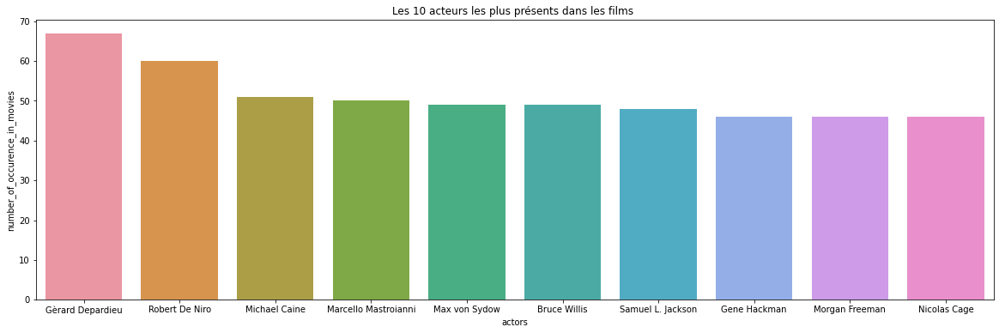

In [62]:
plt.figure(figsize=[20, 6])
sns.barplot(df_cast.head(10).actors,df_cast.head(10).number_of_occurence_in_movies)
plt.title("Les 10 acteurs les plus présents dans les films ")
plt.show()

##### Nombre de films par année

In [77]:
df_nb_movies = pd.DataFrame(dict(Counter(df["year"].values.tolist())).items(),
                            columns=["year","nb_movies"]).sort_values(by="year").reset_index(drop=True)
df_nb_movies

,year,nb_movies
0,1891,1
1,1893,1
2,1894,1
3,1896,2
4,1903,1
...,...,...
107,2012,1102
108,2013,1212
109,2014,1137
110,2015,481


<AxesSubplot:xlabel='year', ylabel='nb_movies'>

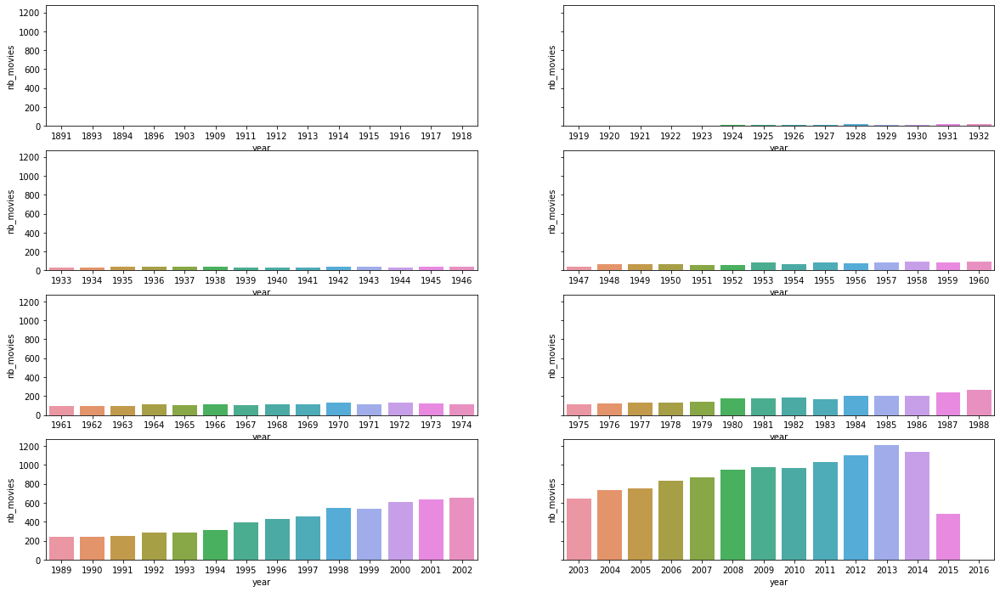

In [118]:
f, axs = plt.subplots(4,2, figsize=(20,12), sharey=True)


## 0
tmp=df_nb_movies.iloc[0:14]
sns.barplot(data= tmp,
                    x="year",
                    y="nb_movies",
                    ax=axs[0,0],
                    )

tmp=df_nb_movies.iloc[14:28]
sns.barplot(data= tmp,
                x="year",
                y="nb_movies",
                ax=axs[0,1],
                )

## 1 
tmp=df_nb_movies.iloc[28:42]
sns.barplot(data= tmp,
                x="year",
                y="nb_movies",
                ax=axs[1,0],
                )

tmp=df_nb_movies.iloc[42:56]
sns.barplot(data= tmp,
                x="year",
                y="nb_movies",
                ax=axs[1,1],
                )

## 2 
tmp=df_nb_movies.iloc[56:70]
sns.barplot(data= tmp,
                x="year",
                y="nb_movies",
                ax=axs[2,0],
                )

tmp=df_nb_movies.iloc[70:84]
sns.barplot(data= tmp,
                x="year",
                y="nb_movies",
                ax=axs[2,1],
                )

## 3
tmp=df_nb_movies.iloc[84:98]
sns.barplot(data= tmp,
                x="year",
                y="nb_movies",
                ax=axs[3,0],
                )

tmp=df_nb_movies.iloc[98:113]
sns.barplot(data= tmp,
                x="year",
                y="nb_movies",
                ax=axs[3,1],
                )

On remarque qu'il y a une évolution dans la production des films en avançant dans le temps. Autrement-dit, il y a eu plus de production de films (x10 quasiment) après l'année 1994 par rapport à avant.